<div style="text-align: center;">
  <h2><strong></strong></h2>
</div>

<center>

## **Wavelet Scattering Transform 2D**
## **A Wavelet Scattering PCA-Based Similarity Classifier for Granular Food Texture Image Recognition Using Cosine Distance Metrics**

### **Autor:** Sebastian Carvalho Salazar  
### **Email:** sebastian.carvalho2596@gmail.com

</center>

# Librerias
---

In [239]:
!pip install kymatio

In [240]:
# Módulos estándar de Python
import os
import zipfile
import shutil
import random
import warnings

# Librerías de procesamiento de datos
import numpy as np
import pandas as pd

# Visualización
import matplotlib.pyplot as plt
import seaborn as sns

# Procesamiento de imágenes
import cv2

# Machine Learning / Deep Learning
from kymatio.sklearn import Scattering2D
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from scipy.spatial.distance import cosine
from scipy.spatial.distance import euclidean
from sklearn.decomposition import KernelPCA
from sklearn.metrics import mean_squared_error
from sklearn.metrics import classification_report
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix
# from kymatio import Scattering2D
# from kymatio.numpy import Scattering2D
# import torch

# Bases de datos
import psycopg2
from sqlalchemy import create_engine

# Pipeline (Funciones)
---

In [241]:
def read_images(img_path):
    """
    Lee una imagen en escala de grises, la normaliza y la redimensiona a 200x200.

    Parámetros:
    - img_path (str): Ruta de la imagen.

    Retorna:
    - np.ndarray: Imagen procesada o None si la imagen no pudo ser cargada.
    """

    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)  # Leer en escala de grises
    if img is None:
        return None
    if len(img.shape) == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img = cv2.resize(img, (200, 200))   # Redimensionar a 200x200

    return img

In [242]:
def extract_and_process_images(zip_path="imagedatabase.zip", output_dir="processed_data",
                               classes = ["Sesameseeds", "Rice", "Pearlsugar", "Oatmeal", "Lentils"],
                               imgs_folder = "kyberge", train_ratio=0.8):
    """
    Extrae imágenes de un archivo ZIP, las convierte a escala de grises, las redimensiona a 200x200
    y las divide en conjuntos de entrenamiento y prueba.

    Parámetros:
    - zip_path: Ruta del archivo ZIP.
    - output_dir: Carpeta donde se guardarán las imágenes procesadas.
    - train_ratio: Proporción de imágenes que irán al conjunto de entrenamiento (el resto será test).

    Retorna:
    - DataFrame con las rutas de imágenes y sus etiquetas.
    """

    # Extraer ZIP
    extract_path = "extracted_images"
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_path)

    # Definir rutas de salida
    train_dir = os.path.join(output_dir, "train")
    test_dir = os.path.join(output_dir, "test")

    os.makedirs(train_dir, exist_ok=True)
    os.makedirs(test_dir, exist_ok=True)

    # Leer imágenes y procesarlas
    image_data = []
    base_path = os.path.join(extract_path, imgs_folder)

    for class_name in classes:
        class_path = os.path.join(base_path, class_name)
        images = sorted(os.listdir(class_path))
        random.shuffle(images)  # Mezclar imágenes para train/test split

        split_index = int(len(images) * train_ratio)
        train_images = images[:split_index]
        test_images = images[split_index:]

        # Procesar imágenes
        for img_name in images:
            img_path = os.path.join(class_path, img_name)

            img = read_images(img_path)
            if img is None:
              continue

            # Definir destino
            is_train = img_name in train_images
            dest_folder = train_dir if is_train else test_dir
            dest_class_folder = os.path.join(dest_folder, class_name)
            os.makedirs(dest_class_folder, exist_ok=True)

            # Guardar imagen procesada
            new_img_path = os.path.join(dest_class_folder, img_name)
            cv2.imwrite(new_img_path, img)

            # Guardar datos en DataFrame
            image_data.append({"image_path": new_img_path, "label": class_name, "set": "train" if is_train else "test"})

    # Crear DataFrame
    df = pd.DataFrame(image_data)

    return df

---

### 📌 Resumen de los efectos de los parámetros `J`, `L` y `max_order` en el Scattering Transform 2D

<style>
  table {width: 100%; border-collapse: collapse; text-align: left;}
  th, td {padding: 10px; border: 1px solid #ddd;}
  th {background-color: #f4f4f4; font-weight: bold; text-align: center;}
  td {vertical-align: top;}
</style>

| **Parámetro** | **🔼 Efecto al Aumentar** | **✅ Beneficio** | **⚠️ Desventaja** | **📌 Ejemplo de Aplicación** |
|--------------|----------------------------|------------------|------------------|---------------------------|
| **`J`** (Escala máxima) | Mayor invariancia a traslaciones (captura estructuras más grandes) | Captura patrones de mayor escala en la imagen | Pierde detalles finos en texturas pequeñas | Análisis de imágenes médicas o satelitales donde la estructura global es importante |
| **`L`** (Número de orientaciones) | Mayor sensibilidad a direcciones y texturas | Permite detectar estructuras direccionales con mayor precisión | Aumenta el costo computacional y el tamaño de salida | Imágenes con texturas complejas (madera, huellas dactilares, textiles) |
| **`max_order`** (Orden del scattering) | Captura interacciones entre frecuencias para analizar estructuras más complejas | Mejora la capacidad de describir variaciones en texturas | Aumenta la dimensionalidad de la salida y el tiempo de cómputo | Análisis de texturas detalladas en imágenes biométricas o de materiales |

---

### 🎯 **Recomendaciones Generales**
- **🔹 Si analizas imágenes con patrones pequeños (detalles finos, bordes afilados)** → Usa **`J` pequeño**.
- **🔹 Si trabajas con texturas ricas en direcciones (madera, textiles, huellas dactilares)** → Usa **`L` más alto**.
- **🔹 Si necesitas capturar relaciones complejas entre frecuencias (texturas avanzadas)** → Usa **`max_order=2`**.
- **🔹 Si buscas eficiencia computacional** → Usa **valores bajos de `J`, `L` y `max_order=1`**.

💡 **Ejemplo práctico**:  
Para imágenes médicas donde interesa la estructura general, un buen punto de partida sería:  
**`J=5, L=4, max_order=2`**.


In [243]:
def create_scattering2d(shape=(200, 200), J=2, L=8):
    """
    Crea un modelo de transformada Scattering2D con los parámetros especificados.

    Parámetros:
    - shape (tuple): Tamaño de la imagen de entrada (alto, ancho). Por defecto (200, 200).
    - J (int): Número de escalas de la transformada. Por defecto 2 (Factor de Escala de Invarianza: 2**J).
    - L (int): Número de orientaciones por escala. Por defecto 6.

    Retorna:
    - Un objeto Scattering2D listo para usar.
    """
    return Scattering2D(J=J, shape=shape, L=L, max_order=2)

---

In [244]:
def compute_scattering2D(scattering=None, dataset=None, img=None):
    """
    Calcula la transformada Scattering2D del dataset o aplica scattering(img).

    Parámetros:
    - scattering (Scattering2D): Modelo de transformada Scattering2D.
    - dataset (numpy array): Imagen de entrada para la transformación con .transform().
    - img (numpy array): Entrada para aplicar scattering() directamente.

    Retorna:
    - numpy array con los coeficientes de Scattering2D o None si hay un error.
    """
    # Validación de parámetros
    if scattering is None:
        warnings.warn("Advertencia: scattering no puede ser None.")
        return None

    if dataset is not None:
        return scattering.transform(dataset)

    if img is not None:
        img = np.expand_dims(img, axis=0)
        return scattering(img)

    # Si ambos son None, advertencia
    warnings.warn("Advertencia: Debe proporcionarse dataset o img.")
    return None

In [245]:
# Función para visualizar la imagen original
def plot_original_image(img):
    """
    Muestra la imagen original en escala de grises, asegurando que se visualice correctamente.
    """
    plt.figure(figsize=(4, 4))

    if img.dtype == np.float32 or img.dtype == np.float64:  # Imagen normalizada
        plt.imshow(img, cmap='gray', vmin=0, vmax=1)  # Definir explícitamente el rango
    else:
        plt.imshow(img, cmap='gray')  # Para imágenes en el rango 0-255

    plt.title("Imagen Original")
    plt.axis("off")
    plt.show()

In [246]:
def plot_scattering_coefficients_spectrogram(Sx, num_coeffs=16, cmap='inferno'):
    """
    Muestra los coeficientes Scattering como imágenes con un colormap de spectrograma.

    Parámetros:
    - Sx (numpy array): Coeficientes Scattering obtenidos de la transformada.
    - num_coeffs (int): Número de coeficientes a mostrar. Máximo 36 (6x6 grid).
    - cmap (str): Colormap a usar. Por defecto 'inferno'.
    """
    rows, cols = 8, 7
    total_subplots = rows * cols

    # Asegurar que num_coeffs no sea mayor a los coeficientes disponibles
    num_coeffs = min(num_coeffs, Sx.shape[1], total_subplots)

    # Crear la figura con subplots
    fig, axes = plt.subplots(rows, cols, figsize=(16, 10))

    # Aplanar la matriz de ejes para fácil iteración
    axes = axes.flatten()

    # Graficar solo los coeficientes disponibles
    for i in range(num_coeffs):
        axes[i].imshow(Sx[0, i], cmap=cmap, aspect='auto', interpolation='bicubic')
        axes[i].axis('off')
        axes[i].set_title(f'Coef. {i+1}')

    # Eliminar subplots vacíos
    for i in range(num_coeffs, total_subplots):
        fig.delaxes(axes[i])

    plt.suptitle("Coeficientes Scattering 2D (Spectrogram Style)")
    plt.tight_layout()
    plt.show()

In [247]:
def visualize_samples(df, num_cols=3, train_or_test='train'):
    """
    Visualiza una muestra de imágenes de cada categoría en una matriz de subplots.

    Parámetros:
    - df: DataFrame que contiene las columnas 'image_path' y 'label'.
    - num_cols: Número de columnas en la visualización (por defecto 3).
    """
    df = df[df['set'] == train_or_test]
    categories = df["label"].unique()

    for i, category in enumerate(categories):
        # Seleccionar una imagen aleatoria de la categoría
        sample_df = df[df["label"] == category]
        sample_path = random.choice(sample_df["image_path"].values)

        # Cargar imagen
        img = read_images(sample_path)
        img = img.astype(np.float32) / 255.0
        plot_original_image(img)

        # Calcular coeficientes Scattering2D
        Sx = compute_scattering2D(img=img, scattering=scattering_model)

        # Generar gráficos con colormap tipo spectrograma
        plot_scattering_coefficients_spectrogram(Sx, num_coeffs=7*8, cmap='coolwarm')

# Preparación de los Datos

In [248]:
# Crear Conjunto de Train y Test
df_images = extract_and_process_images(zip_path="/content/imagedatabae.zip", output_dir="/content/processed_data",
                               classes = ["Sesameseeds", "Rice", "Pearlsugar", "Oatmeal", "Lentils"],
                               imgs_folder = "kyberge", train_ratio=0.8)

In [249]:
df_images.head()

,image_path,label,set
0,/content/processed_data/train/Sesameseeds/73.jpg,Sesameseeds,train
1,/content/processed_data/train/Sesameseeds/77.jpg,Sesameseeds,train
2,/content/processed_data/train/Sesameseeds/157.jpg,Sesameseeds,train
3,/content/processed_data/train/Sesameseeds/67.jpg,Sesameseeds,train
4,/content/processed_data/train/Sesameseeds/159.jpg,Sesameseeds,train


In [250]:
# Wavelet Scattering Transform
scattering_model = create_scattering2d(shape=(200, 200), J=6, L=8)

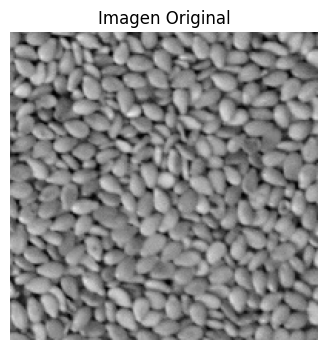

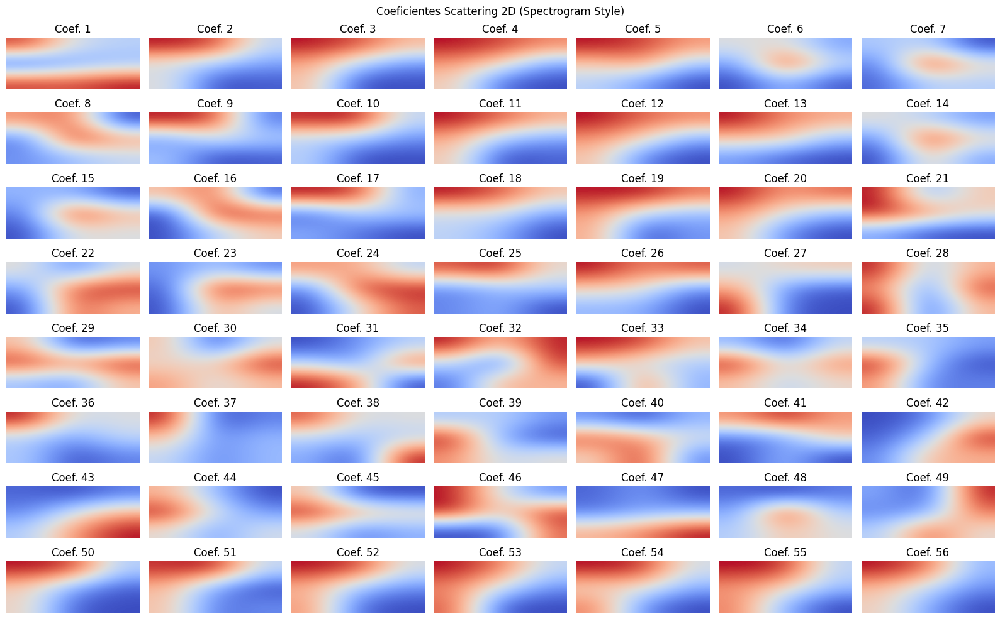

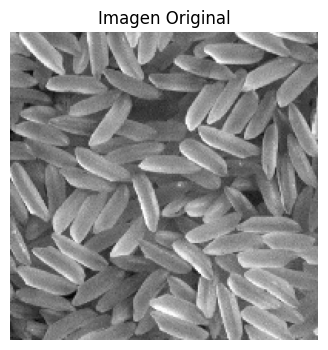

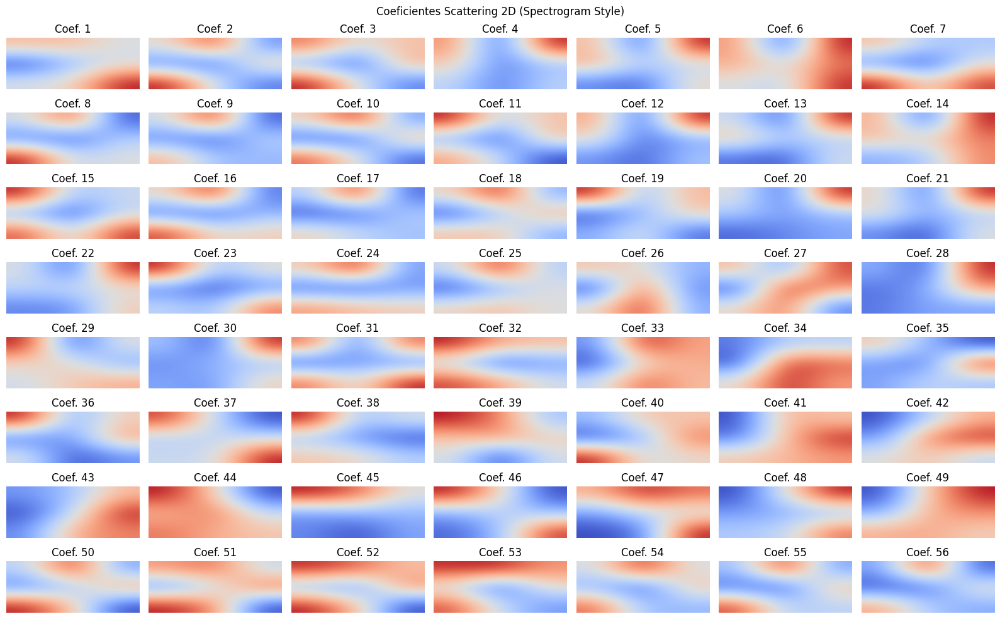

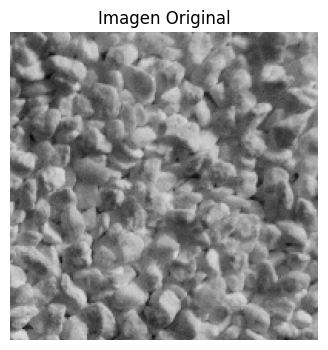

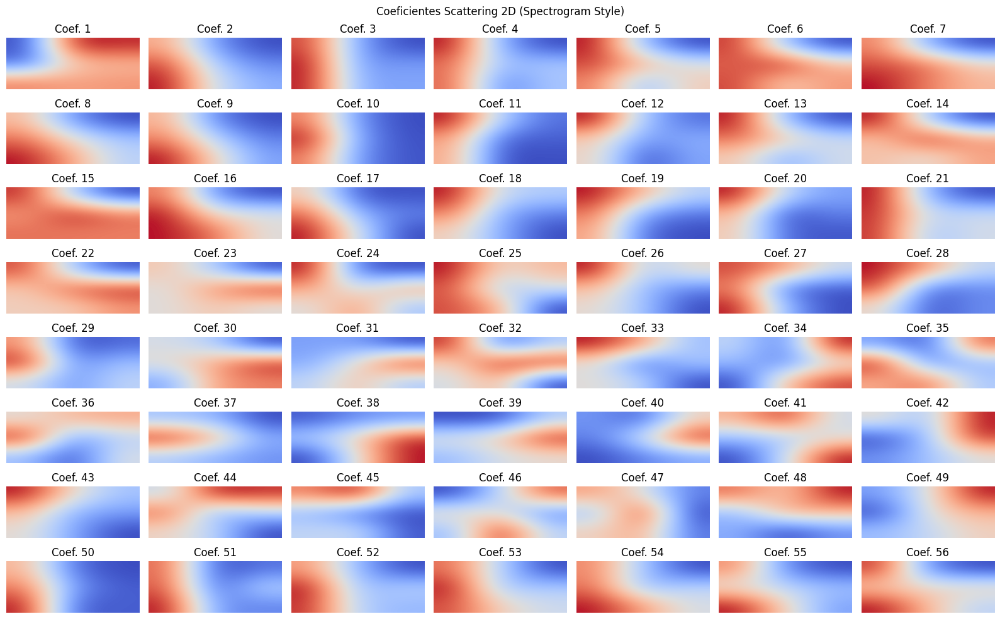

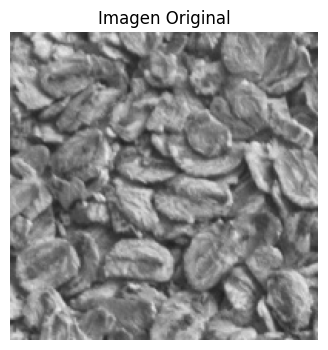

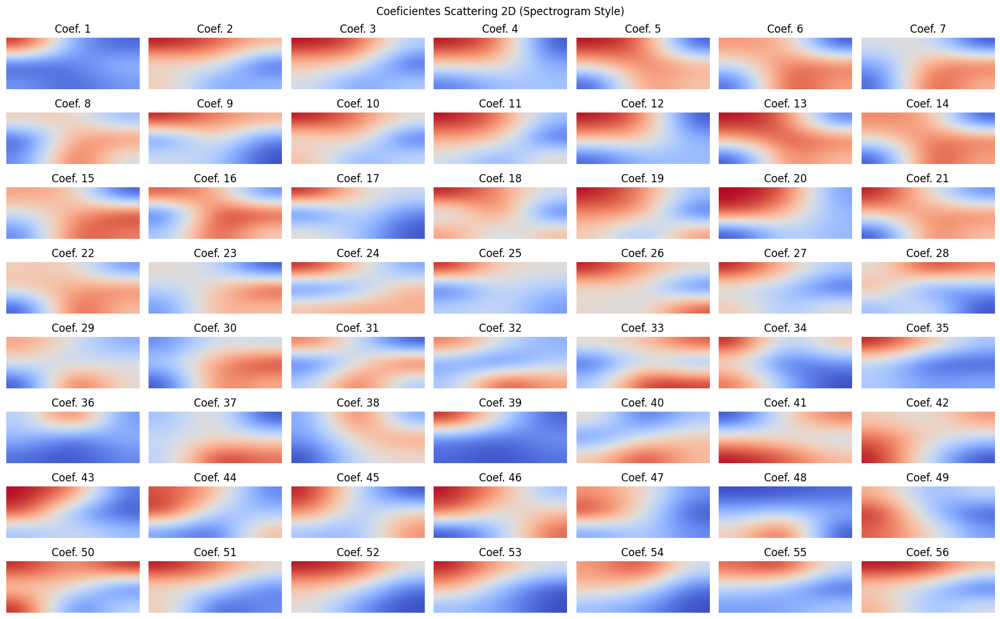

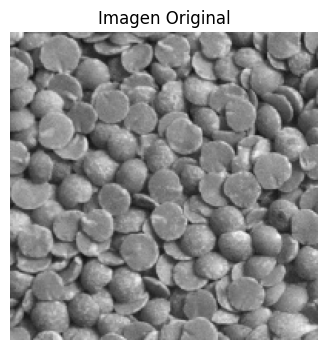

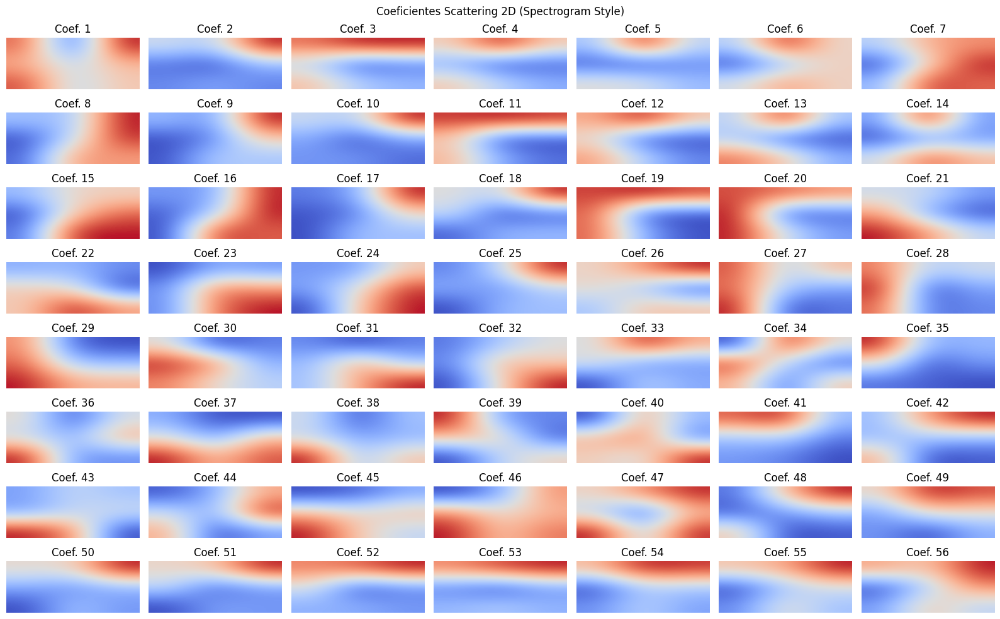

In [251]:
# Visualizar Datos
visualize_samples(df_images, train_or_test='train')

In [252]:
# Filtrar el conjunto de entrenamiento
df_train = df_images[df_images["set"] == "train"]

In [253]:
# Lista para almacenar las imágenes y sus metadatos
test_imgs = []
image_paths = []
labels = []

# Iterar sobre las imágenes en el DataFrame
for img_path, label in zip(df_train["image_path"].values, df_train["label"].values):
    # Leer imagen en escala de grises
    img = read_images(img_path)
    if img is None:
        continue  # Saltar imágenes no válidas

    # Normalizar imagen a rango [0,1]
    img = img.astype(np.float32) / 255.0

    # Almacenar la imagen y sus metadatos
    test_imgs.append(img)
    image_paths.append(img_path)
    labels.append(label)

# Convertir lista de imágenes en un array
test_imgs_arr = np.array(test_imgs)

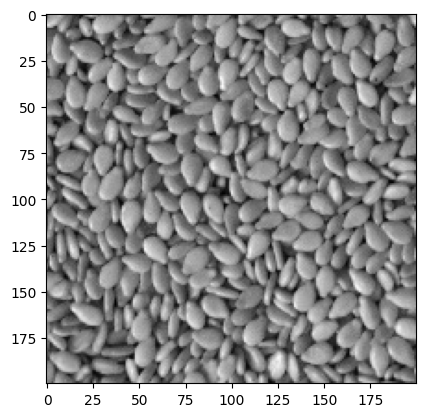

In [254]:
# Visualización
k  = np.random.randint(test_imgs_arr.shape[0])
plt.imshow(test_imgs_arr[k], cmap='gray')
plt.show()

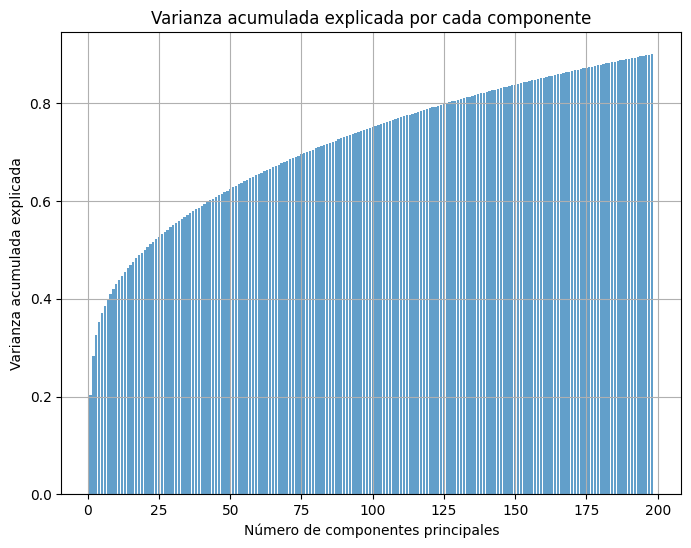

Dimensiones totales: 9081
Dimensiones después de PCA: 198
Porcentaje de dimensiones eliminadas: 97.82%


In [255]:
# Calcular coeficientes de Scattering2D
X_train_scattering = compute_scattering2D(scattering=scattering_model, dataset=test_imgs_arr)

# Aplicar StandardScaler para normalizar las características
scaler = StandardScaler()
X_train_scattering_scaled = scaler.fit_transform(X_train_scattering)

# Aplicar PCA para retener el X% de la varianza explicada
pca = PCA(n_components=0.9)
X_train_scattering_pca = pca.fit_transform(X_train_scattering_scaled)

# Crear DataFrame con los coeficientes de PCA
df_wst_features = pd.DataFrame(X_train_scattering_pca)

# Agregar columnas de metadatos
df_wst_features.insert(0, "image_path", image_paths)
df_wst_features.insert(1, "label", labels)

# Calcular la varianza acumulada explicada
cumulative_variance = np.cumsum(pca.explained_variance_ratio_)

# Diagrama de barras de la varianza acumulada explicada
plt.figure(figsize=(8,6))
plt.bar(range(1, len(cumulative_variance) + 1), cumulative_variance, align='center', alpha=0.7)
plt.xlabel('Número de componentes principales')
plt.ylabel('Varianza acumulada explicada')
plt.title('Varianza acumulada explicada por cada componente')
plt.grid()
plt.show()

# Calcular dimensiones y porcentaje de reducción
dim_totales = X_train_scattering_scaled.shape[1]
dim_pca = X_train_scattering_pca.shape[1]
porcentaje_eliminado = ((dim_totales - dim_pca) / dim_totales) * 100

print(f"Dimensiones totales: {dim_totales}")
print(f"Dimensiones después de PCA: {dim_pca}")
print(f"Porcentaje de dimensiones eliminadas: {porcentaje_eliminado:.2f}%")

In [256]:
df_wst_features.shape

(320, 200)

In [257]:
df_wst_features.head()

,image_path,label,0,1,2,3,4,5,6,7,...,188,189,190,191,192,193,194,195,196,197
0,/content/processed_data/train/Sesameseeds/73.jpg,Sesameseeds,67.002739,-7.144125,-11.732670,-2.533661,18.770779,1.637171,-21.282082,11.211846,...,1.066178,1.984578,0.934868,-0.566709,1.869289,2.033116,0.328680,0.494799,-5.788652,-4.408179
1,/content/processed_data/train/Sesameseeds/77.jpg,Sesameseeds,83.151688,10.202971,-13.081959,-11.975688,-24.703112,8.411036,7.379725,-0.717740,...,1.798967,1.449879,2.598779,-2.976168,-6.283322,-5.733828,-3.334083,-1.237726,-2.912823,2.243205
2,/content/processed_data/train/Sesameseeds/157.jpg,Sesameseeds,76.825569,1.812300,-15.596819,0.373688,-22.664289,1.767141,0.543063,0.937257,...,-1.935325,-1.611658,-3.304553,-0.511403,4.091228,0.530239,1.578922,-3.454801,0.323738,-1.673288
3,/content/processed_data/train/Sesameseeds/67.jpg,Sesameseeds,87.705238,10.290006,-10.082999,-22.193977,15.932254,-6.693444,3.748296,-10.473866,...,-5.836412,-3.221790,1.439647,-1.106829,3.790716,2.865467,-0.885955,2.425522,-1.363632,2.672301
4,/content/processed_data/train/Sesameseeds/159.jpg,Sesameseeds,56.876499,6.465665,-22.876574,32.521168,-28.060158,7.285235,-0.217648,8.550572,...,-5.017149,2.887820,1.784600,-3.748879,-0.692616,-4.754404,-1.664531,-7.065679,2.549245,4.360324


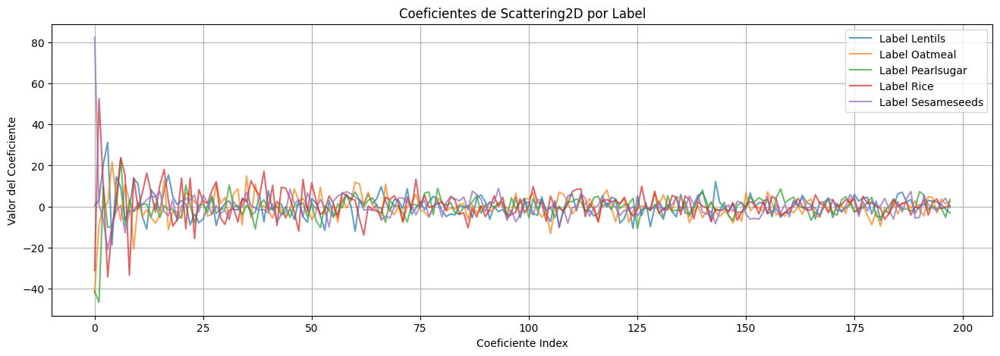

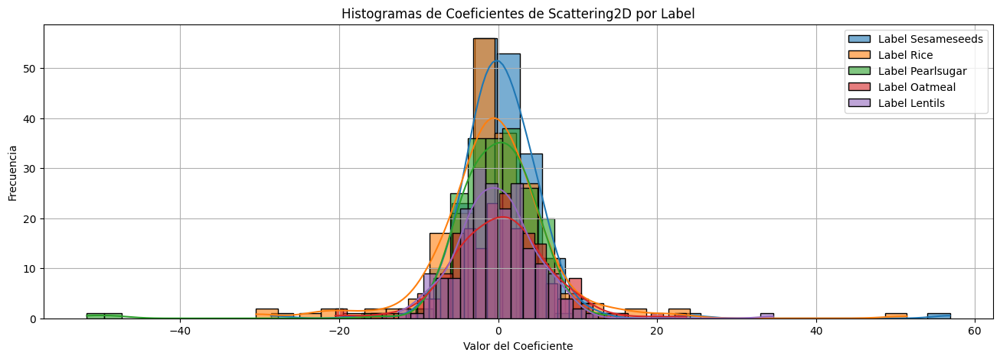

In [262]:
# Seleccionar aleatoriamente una imagen por cada label
df_sample = df_wst_features.groupby("label").sample(n=1, random_state=42)

# Graficar coeficientes de Scattering2D
plt.figure(figsize=(16, 5))
for _, row in df_sample.iterrows():
    plt.plot(row.index[2:], row.values[2:], label=f"Label {row['label']}", alpha=0.7)

plt.xlabel("Coeficiente Index")
plt.ylabel("Valor del Coeficiente")
plt.title("Coeficientes de Scattering2D por Label")
plt.legend()
plt.grid(True)
plt.show()

# Graficar histogramas de coeficientes de Scattering2D por label
plt.figure(figsize=(16, 5))
for label in df_wst_features['label'].unique():
    coef_values = df_wst_features[df_wst_features['label'] == label].iloc[:, 2:].sample(1).values.flatten()
    sns.histplot(coef_values, kde=True, label=f"Label {label}", alpha=0.6, bins=30)

plt.xlabel("Valor del Coeficiente")
plt.ylabel("Frecuencia")
plt.title("Histogramas de Coeficientes de Scattering2D por Label")
plt.legend()
plt.grid(True)
plt.show()

<ipython-input-259-5feacba4eb86>:16: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('viridis', len(categories))  # Colormap con un color para cada categoría



 Forma de las características reducidas: (320, 2)


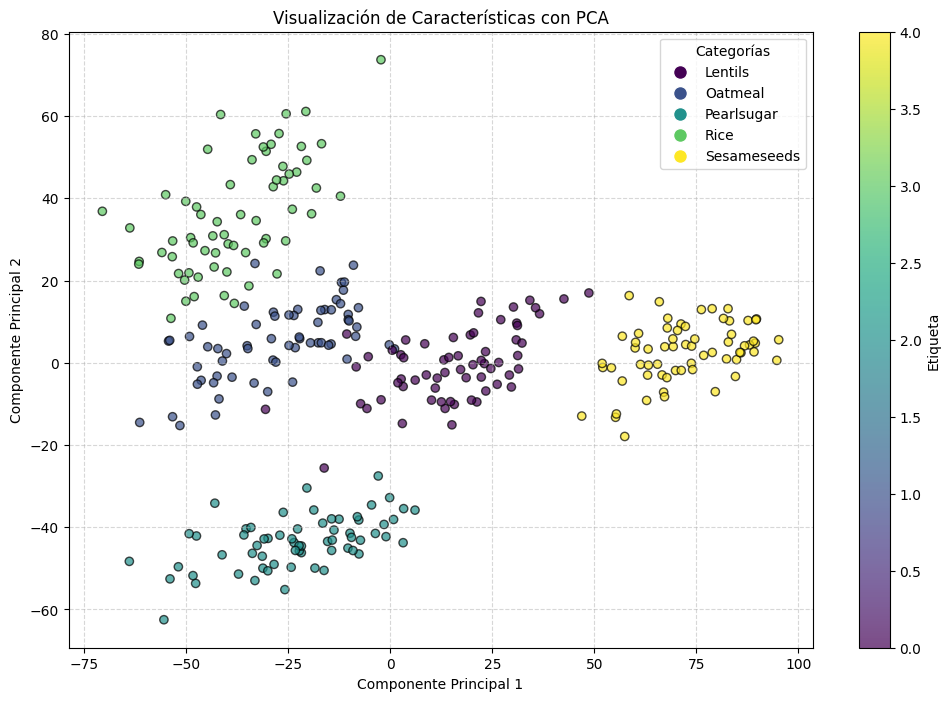

In [259]:
# Asegurar que df_wst_features está definido y contiene las columnas necesarias
if 'label' not in df_wst_features.columns:
    raise ValueError("La columna 'label' no está presente en el DataFrame.")

# Seleccionar características desde la tercera columna en adelante
X_features = df_wst_features.iloc[:, 2:].values
labels = df_wst_features['label'].values

# Convertir etiquetas categóricas a numéricas
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(labels)

# Obtener las categorías originales y sus colores asociados
categories = label_encoder.classes_  # Lista de nombres de las categorías
unique_labels = np.unique(labels_encoded)  # Lista de valores numéricos asignados
cmap = plt.cm.get_cmap('viridis', len(categories))  # Colormap con un color para cada categoría

# Aplicar PCA para reducir a 2 dimensiones
pca_plot = PCA(n_components=2)
X_pca = pca_plot.fit_transform(X_features)

# Imprimir la forma de las características transformadas
print("\n Forma de las características reducidas:", X_pca.shape)

# Graficar las dos primeras componentes principales
plt.figure(figsize=(12, 8))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=labels_encoded, cmap='viridis', alpha=0.7, edgecolors='k')

# Crear la leyenda manualmente
from matplotlib.lines import Line2D
legend_elements = [Line2D([0], [0], marker='o', color='w', markerfacecolor=cmap(i), markersize=10, label=categories[i])
                   for i in range(len(categories))]

plt.legend(handles=legend_elements, title="Categorías", loc="upper right")

plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.title('Visualización de Características con PCA')
plt.colorbar(scatter, label='Etiqueta')  # Muestra la escala de colores
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

Predicción: Sesameseeds, Distancia: 0.17215044414481262


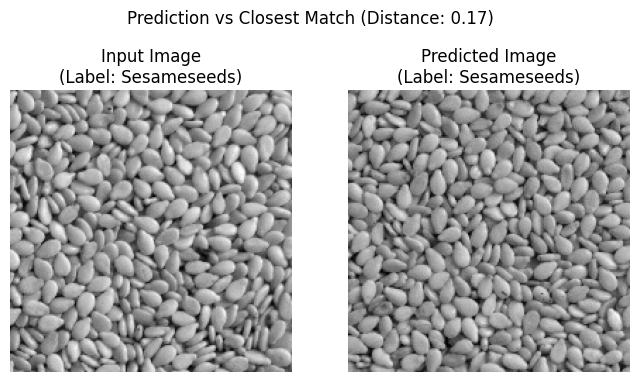

Predicción: Rice, Distancia: 0.5571930922574114


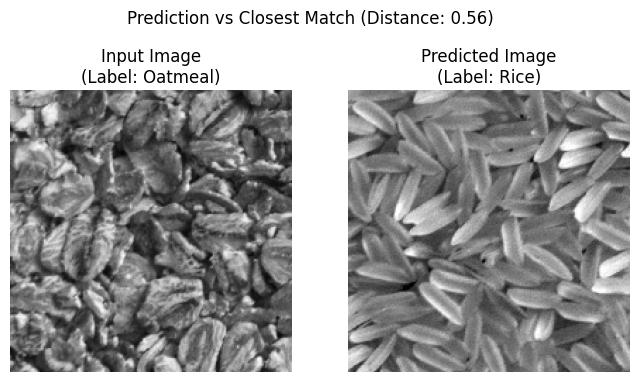

Predicción: Rice, Distancia: 0.36058984957830065


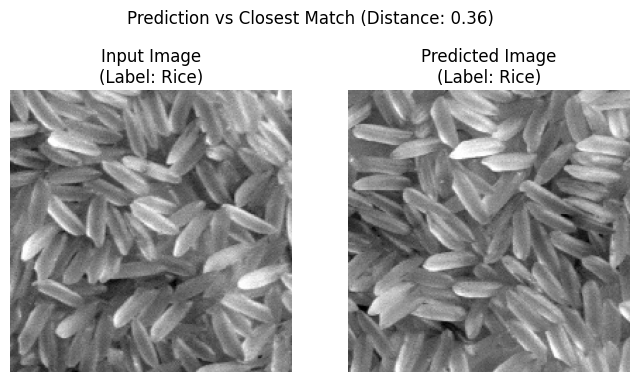

Predicción: Pearlsugar, Distancia: 0.2964303739731452


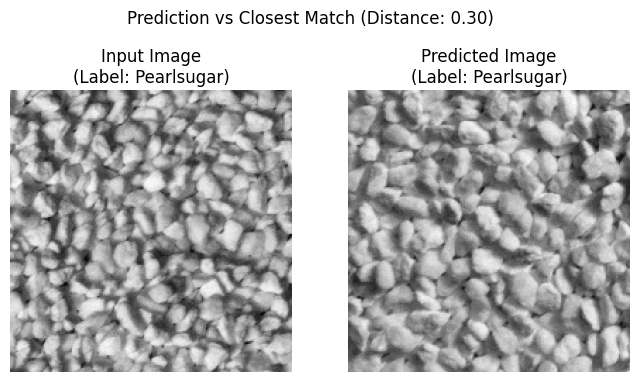

Predicción: Rice, Distancia: 0.3898333064496332


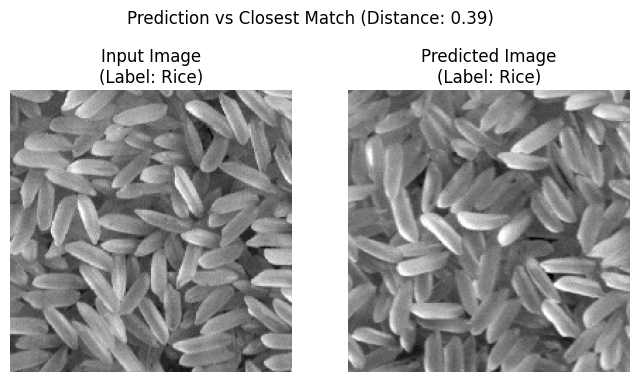

Predicción: Oatmeal, Distancia: 0.655303590620596


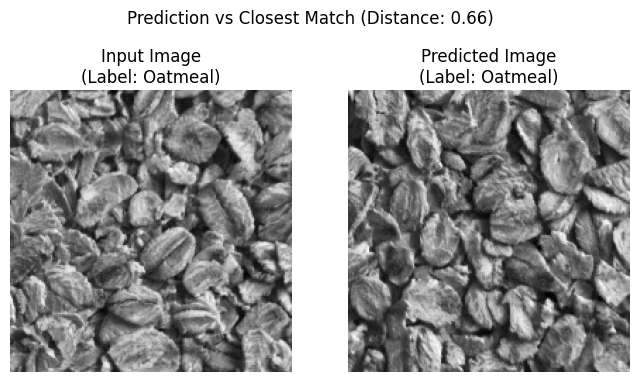

Predicción: Rice, Distancia: 0.4701612569520143


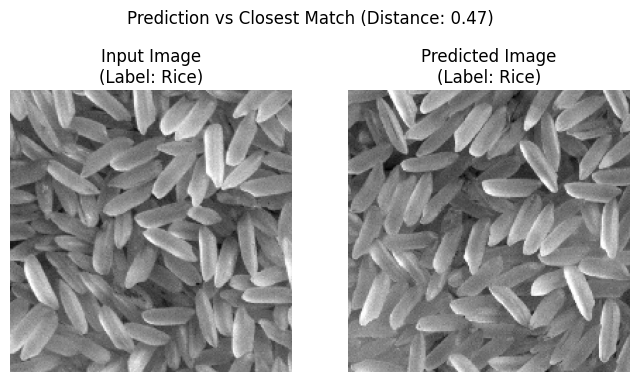

Predicción: Oatmeal, Distancia: 0.4991430585418596


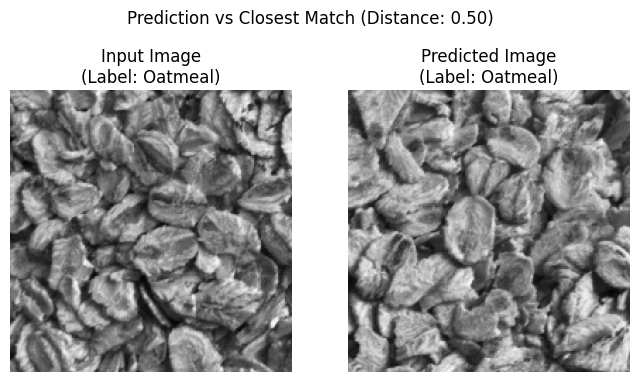

Predicción: Rice, Distancia: 0.579642243534891


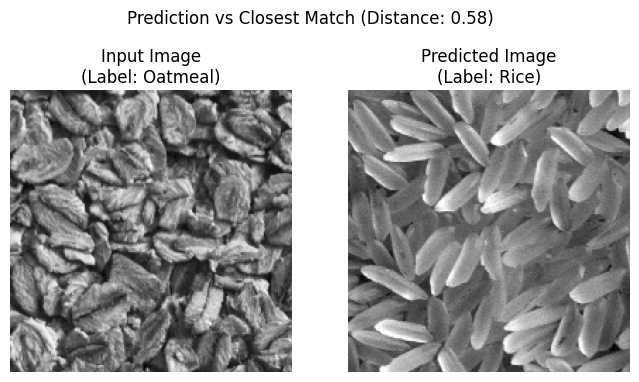

Predicción: Sesameseeds, Distancia: 0.24261398830260805


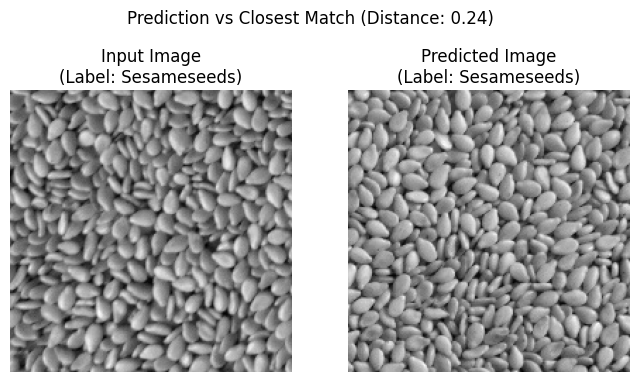

Predicción: Lentils, Distancia: 0.4560602875297748


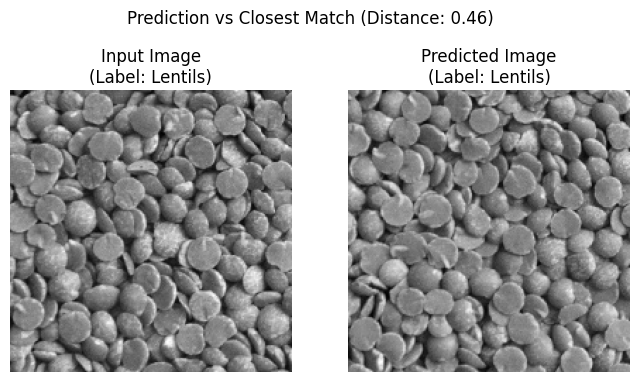

Predicción: Rice, Distancia: 0.5779385021889202


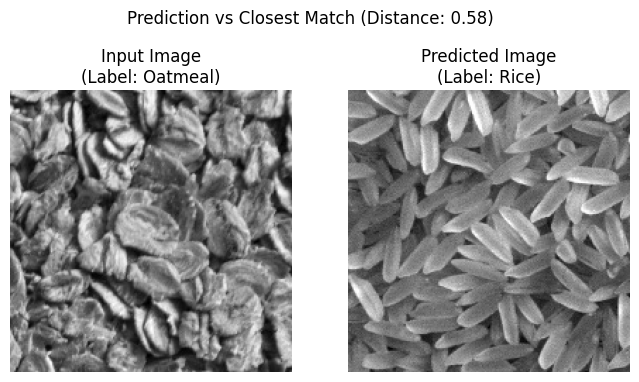

Predicción: Pearlsugar, Distancia: 0.20520829876946578


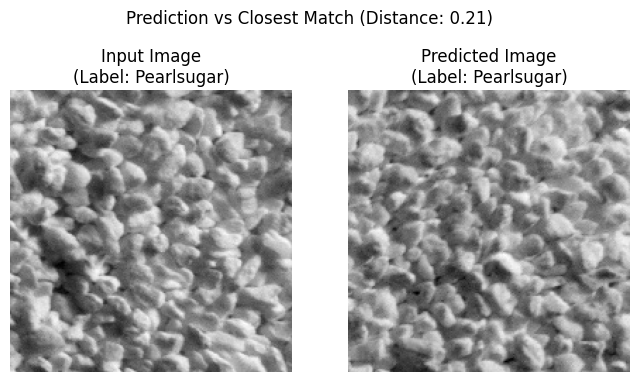

Predicción: Oatmeal, Distancia: 0.5489572330215815


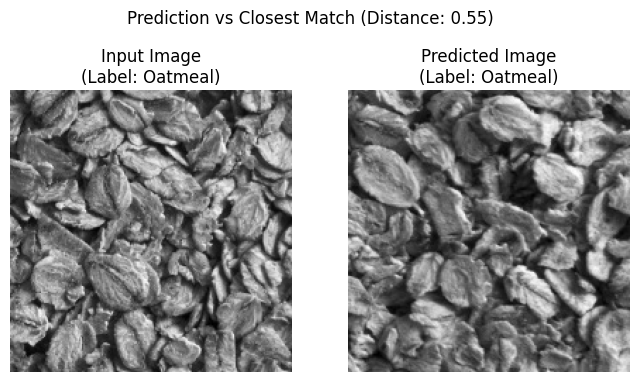

Predicción: Pearlsugar, Distancia: 0.3333338506331639


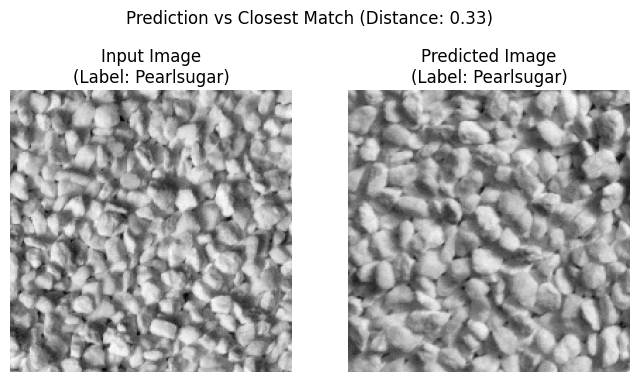

Predicción: Oatmeal, Distancia: 0.4820189933189465


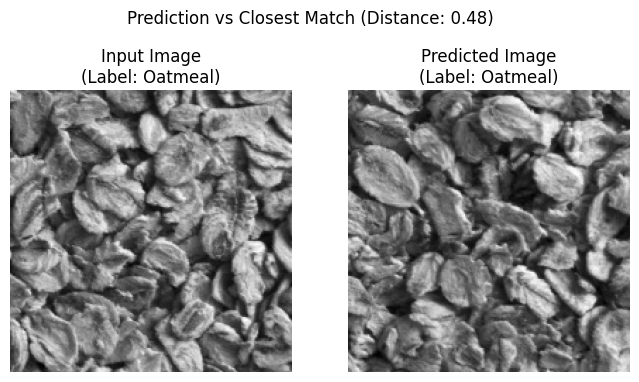

Predicción: Lentils, Distancia: 0.5001010925468845


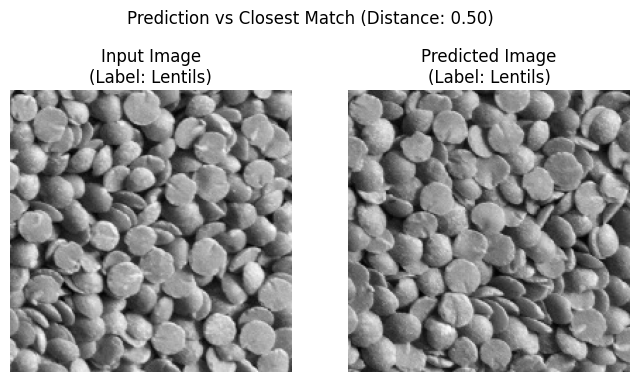

Predicción: Pearlsugar, Distancia: 0.29539913583600497


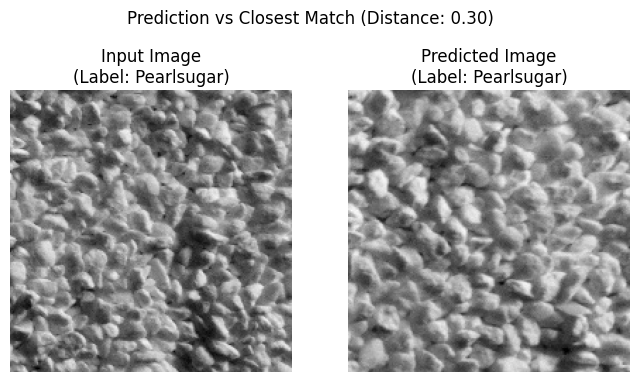

Predicción: Pearlsugar, Distancia: 0.32080060516863096


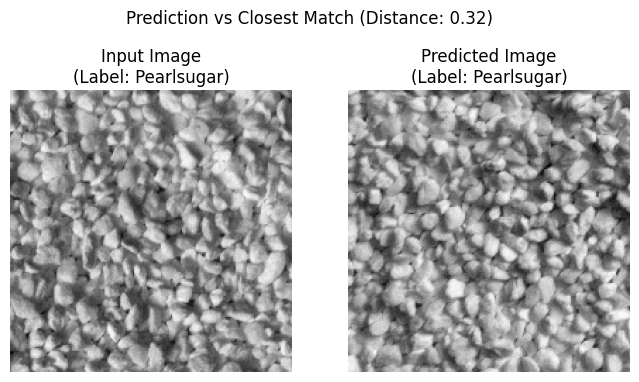

Predicción: Oatmeal, Distancia: 0.6298134214673635


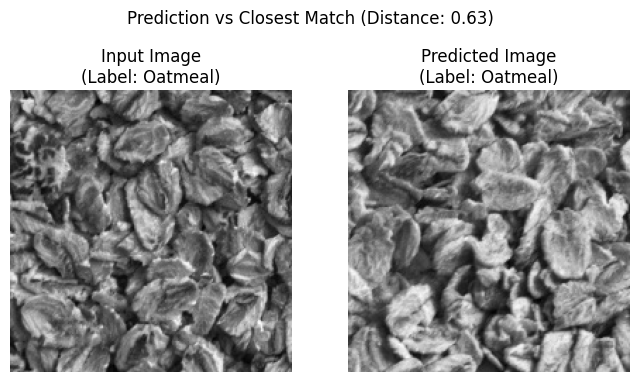

Predicción: Pearlsugar, Distancia: 0.32274139747672337


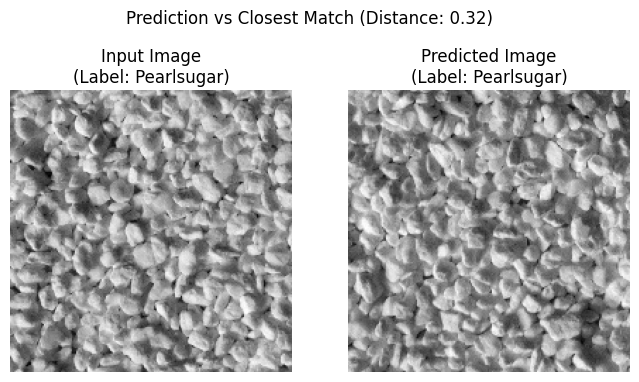

Predicción: Sesameseeds, Distancia: 0.19840803409741747


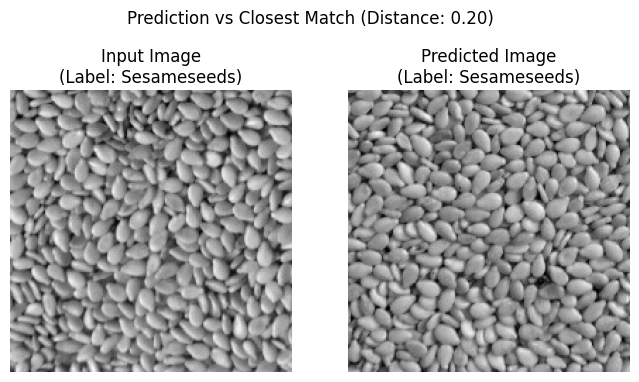

Predicción: Lentils, Distancia: 0.41525090262462794


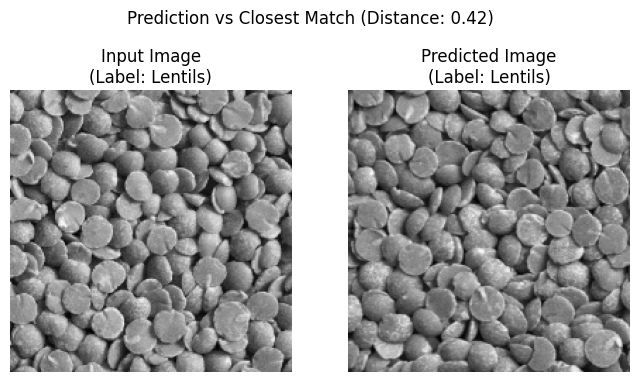

Predicción: Sesameseeds, Distancia: 0.19309678351917714


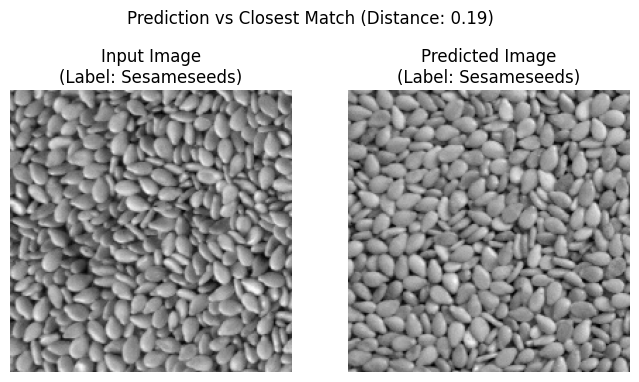

Predicción: Pearlsugar, Distancia: 0.38874930559663146


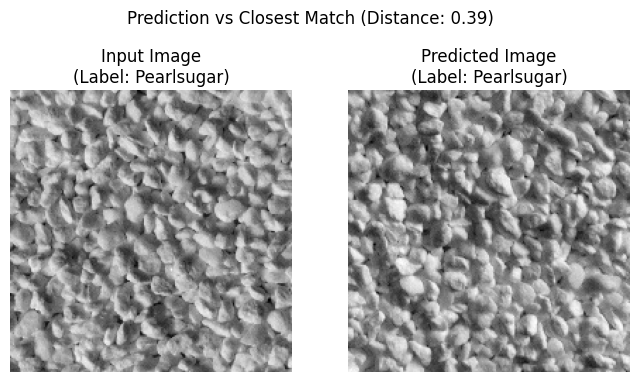

Predicción: Rice, Distancia: 0.42616351950103604


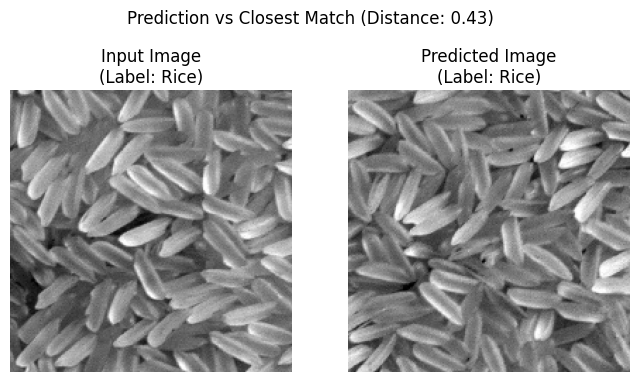

Predicción: Oatmeal, Distancia: 0.5384678395858982


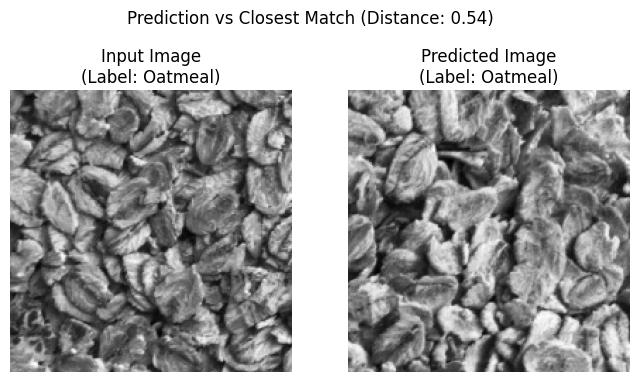

Predicción: Sesameseeds, Distancia: 0.17789386692351805


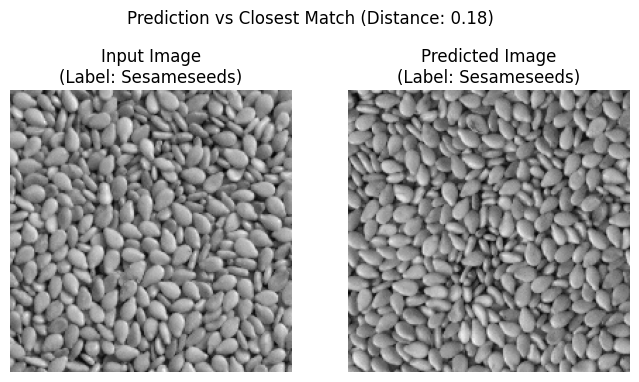

Predicción: Pearlsugar, Distancia: 0.25645310662101606


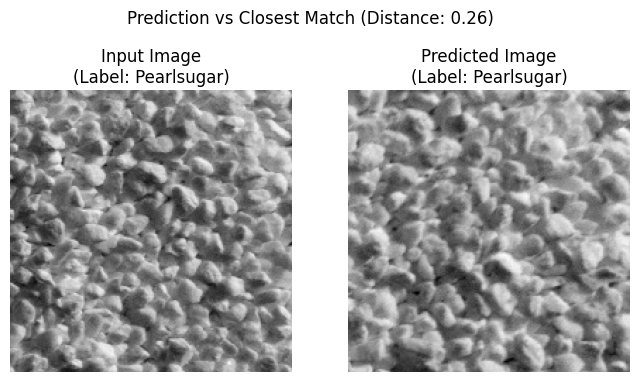

Predicción: Oatmeal, Distancia: 0.5758310344563262


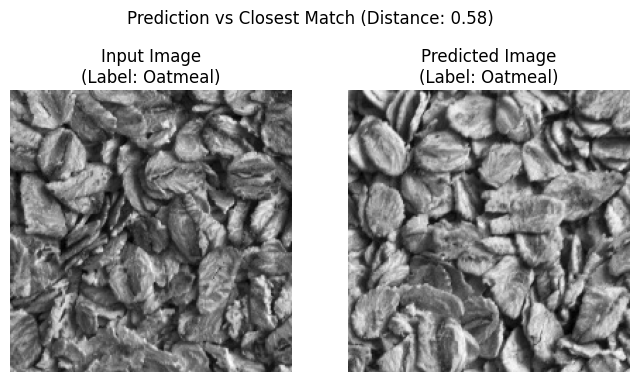

Predicción: Lentils, Distancia: 0.4984527668985991


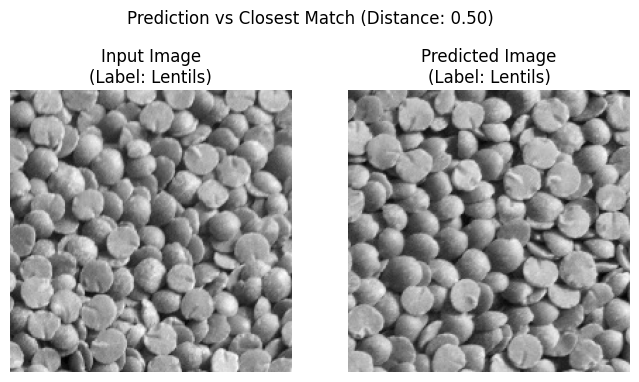

Predicción: Lentils, Distancia: 0.43854784575637407


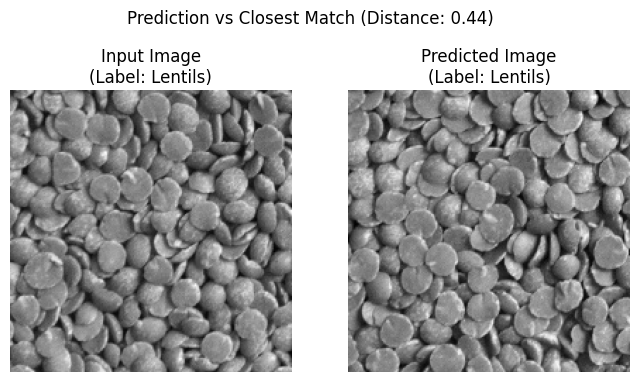

Predicción: Sesameseeds, Distancia: 0.18829334830730915


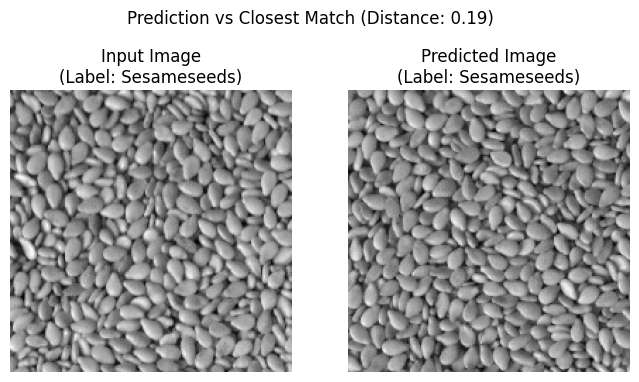

Predicción: Pearlsugar, Distancia: 0.4847588581468718


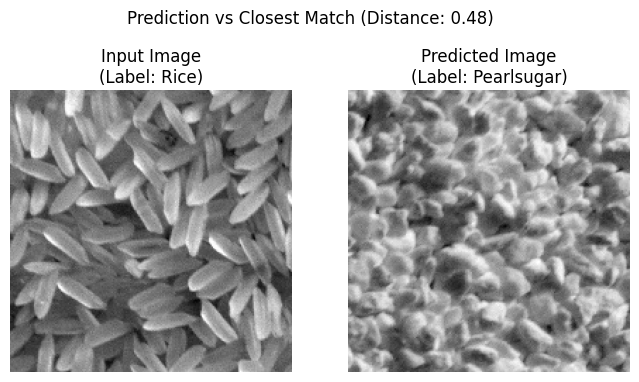

Predicción: Sesameseeds, Distancia: 0.16457408522769879


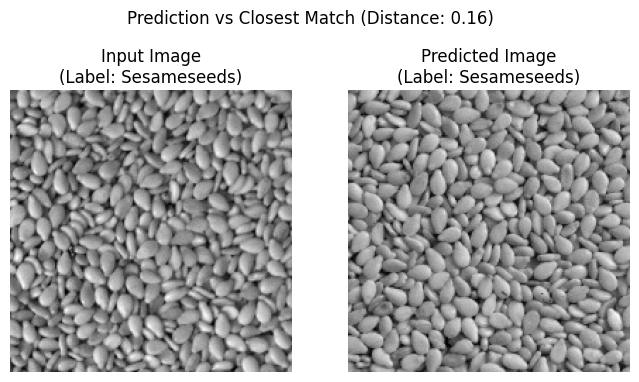

Predicción: Sesameseeds, Distancia: 0.15973213183144153


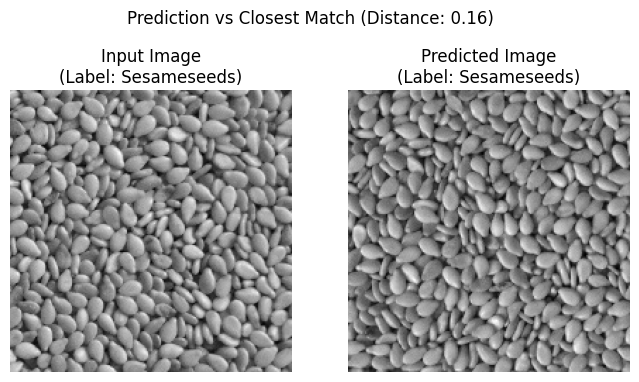

Predicción: Lentils, Distancia: 0.5131896600674768


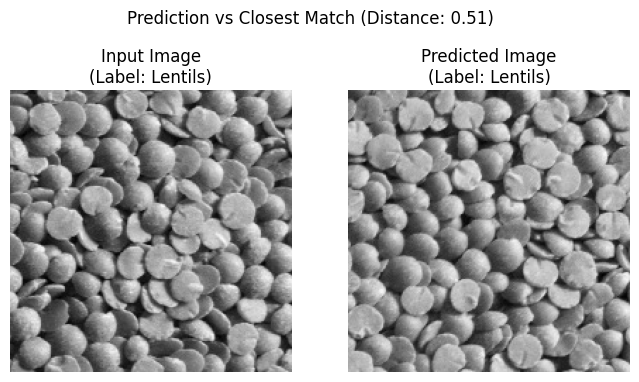

Predicción: Pearlsugar, Distancia: 0.2921716780689543


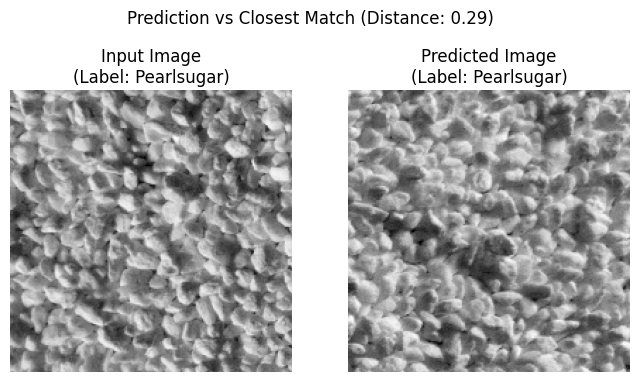

Predicción: Rice, Distancia: 0.49140077565528895


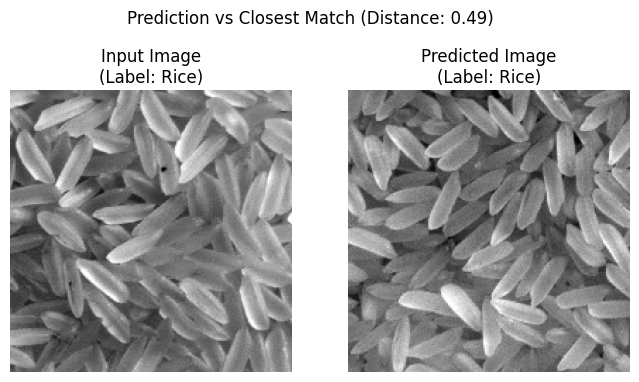

Predicción: Rice, Distancia: 0.44463684619389654


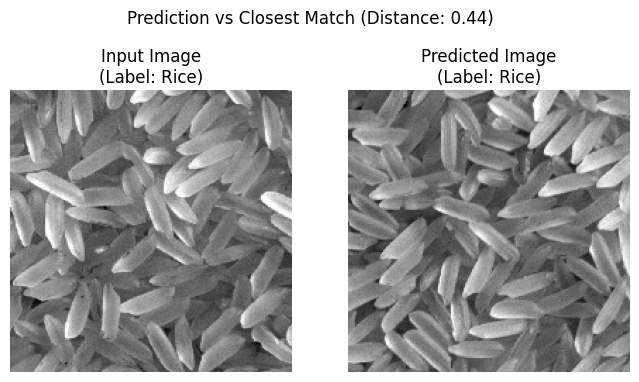

Predicción: Lentils, Distancia: 0.45473892667787896


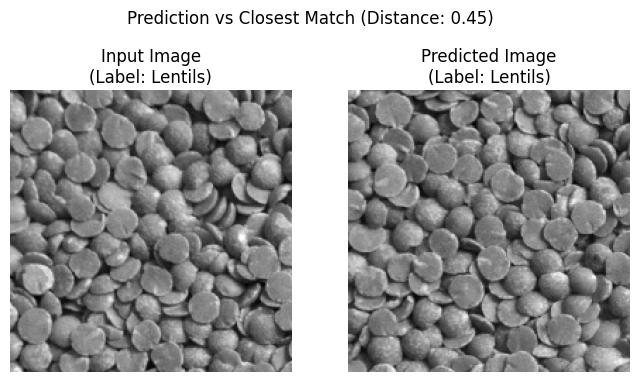

Predicción: Sesameseeds, Distancia: 0.17562635020934902


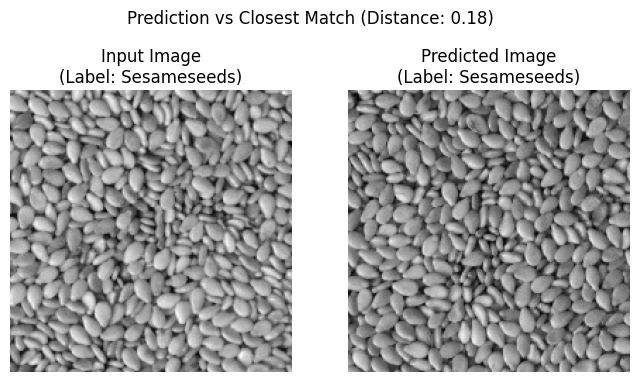

Predicción: Rice, Distancia: 0.4906237378490812


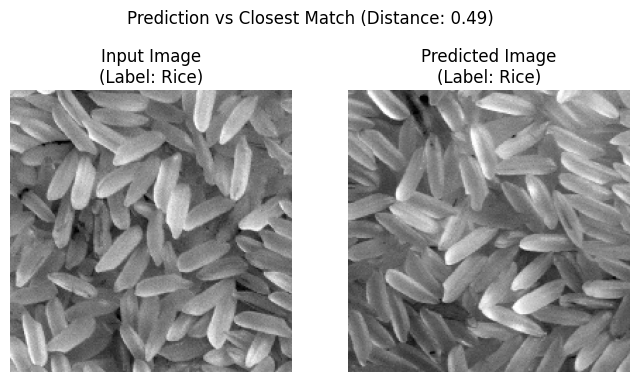

Predicción: Lentils, Distancia: 0.433846445908047


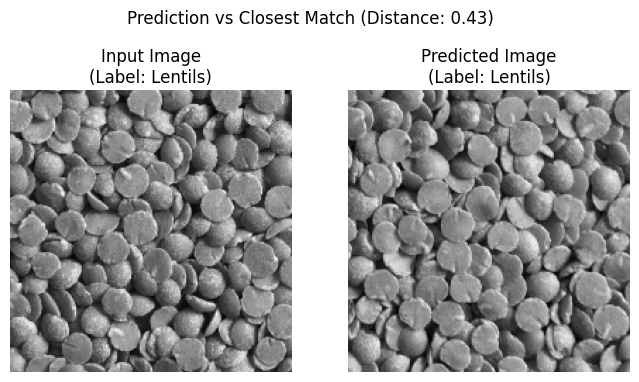

Predicción: Lentils, Distancia: 0.4288904060138674


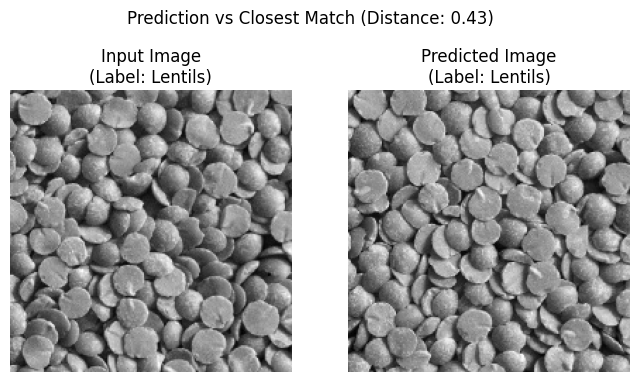

Predicción: Rice, Distancia: 0.5735330299116891


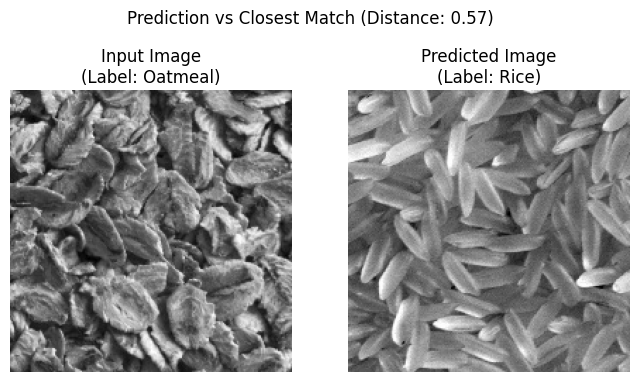

Predicción: Oatmeal, Distancia: 0.6525897072305328


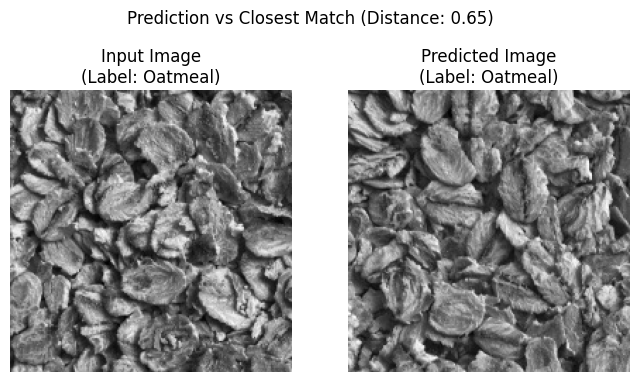

Predicción: Oatmeal, Distancia: 0.5542553254082292


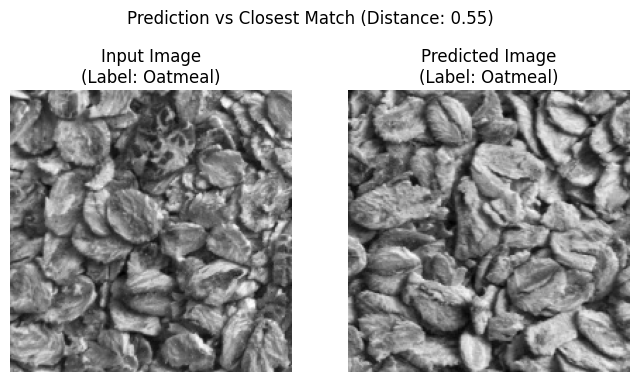

Predicción: Rice, Distancia: 0.6143689411061498


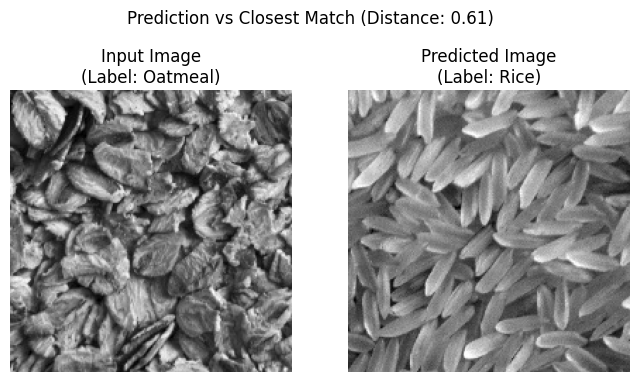

Predicción: Sesameseeds, Distancia: 0.2577964037980047


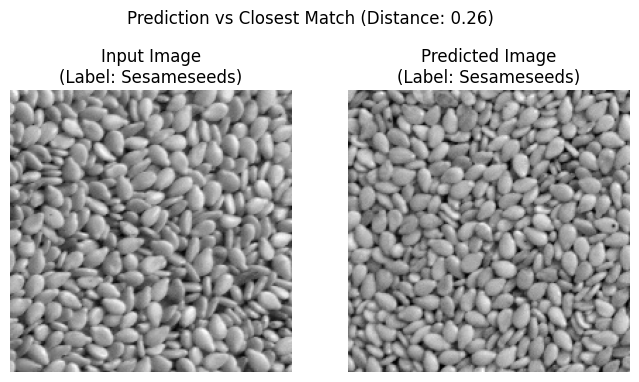

Predicción: Rice, Distancia: 0.4367874385155722


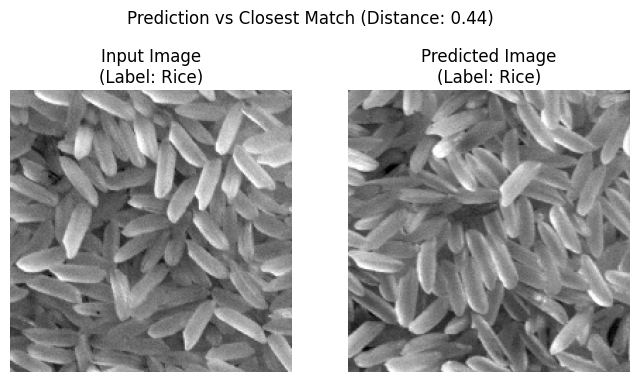

Predicción: Sesameseeds, Distancia: 0.18829544936606268


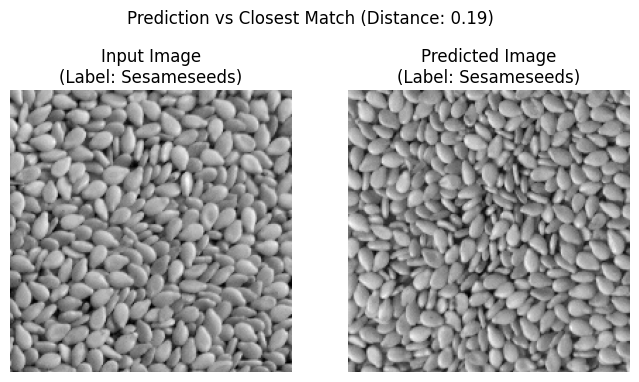

Predicción: Sesameseeds, Distancia: 0.17673886018206053


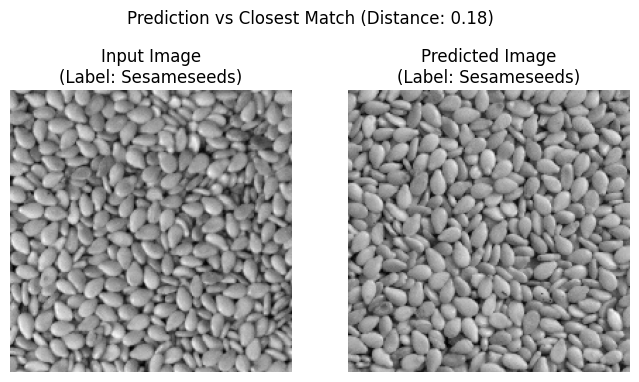

Predicción: Rice, Distancia: 0.4581564822133297


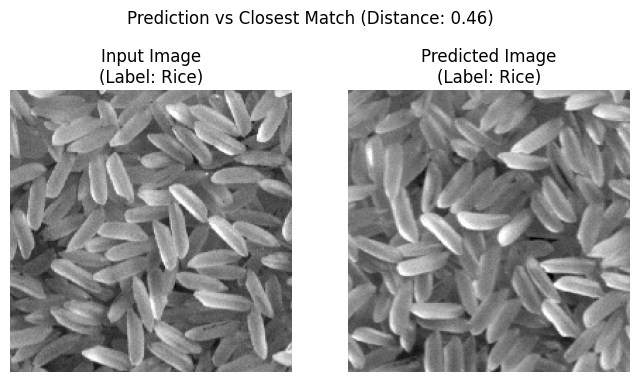

Predicción: Rice, Distancia: 0.4403590354503075


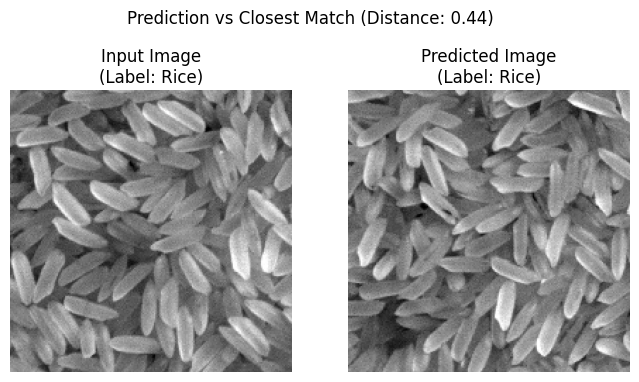

Predicción: Rice, Distancia: 0.4141796068949021


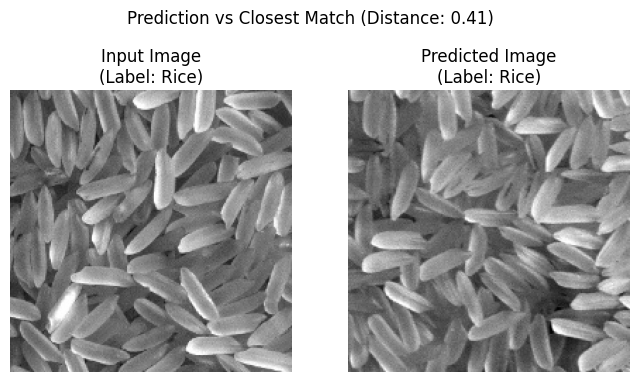

Predicción: Pearlsugar, Distancia: 0.2708488318792255


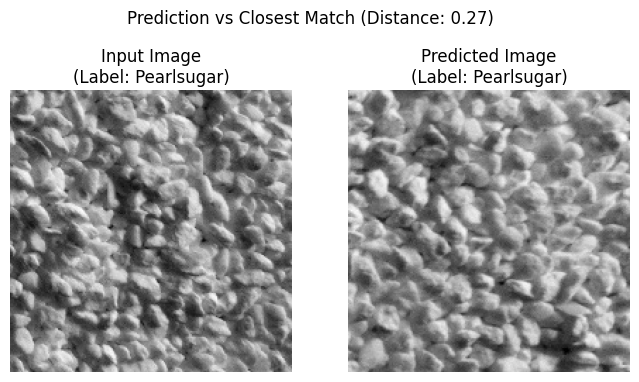

Predicción: Pearlsugar, Distancia: 0.32903399433525193


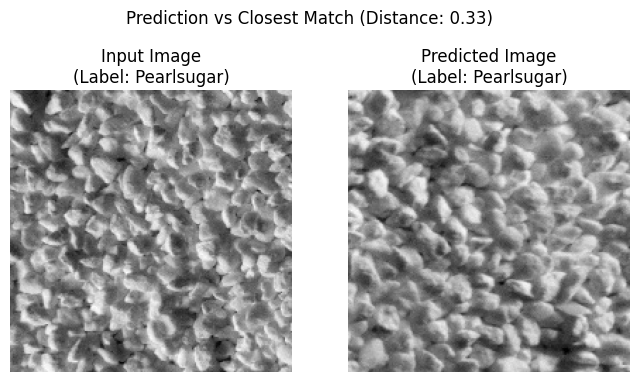

Predicción: Rice, Distancia: 0.4734402776064345


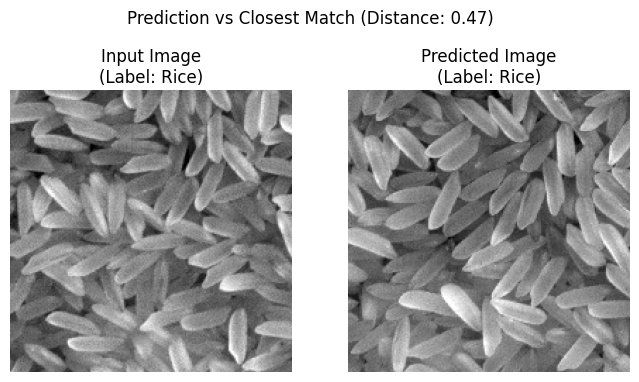

Predicción: Lentils, Distancia: 0.40747089932408176


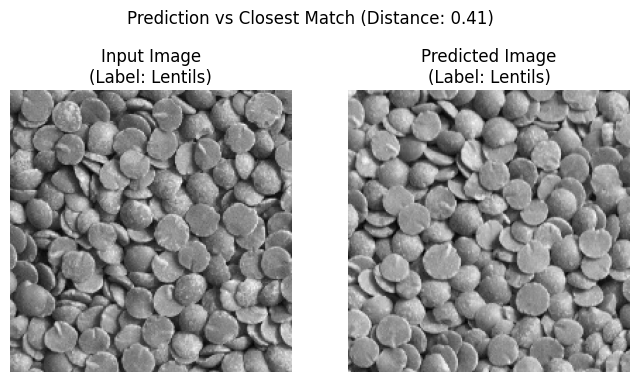

Predicción: Lentils, Distancia: 0.4594722695284482


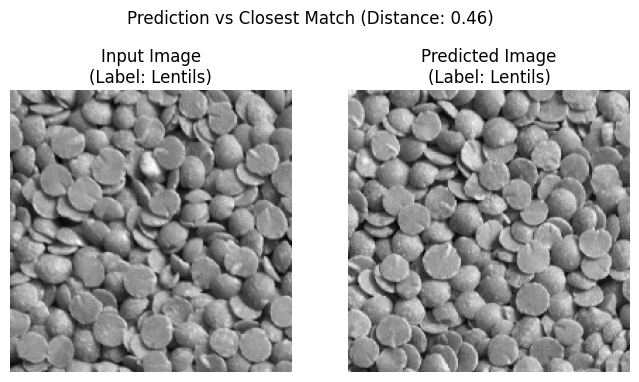

Predicción: Pearlsugar, Distancia: 0.32150548120481703


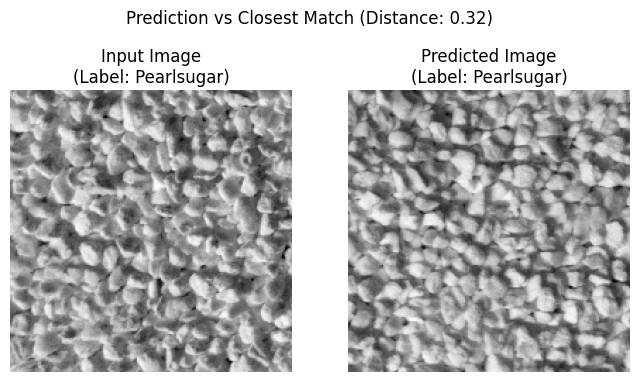

Predicción: Sesameseeds, Distancia: 0.19308537566118633


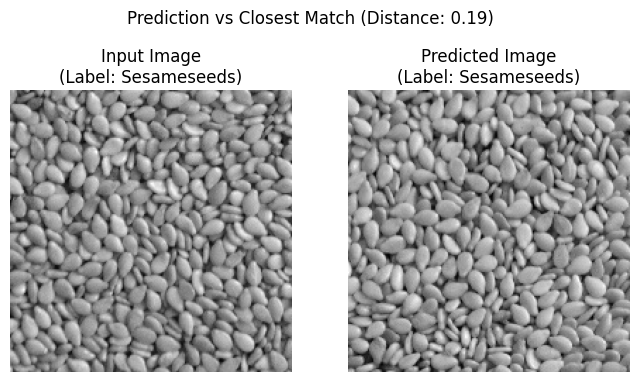

Predicción: Sesameseeds, Distancia: 0.18803107466098556


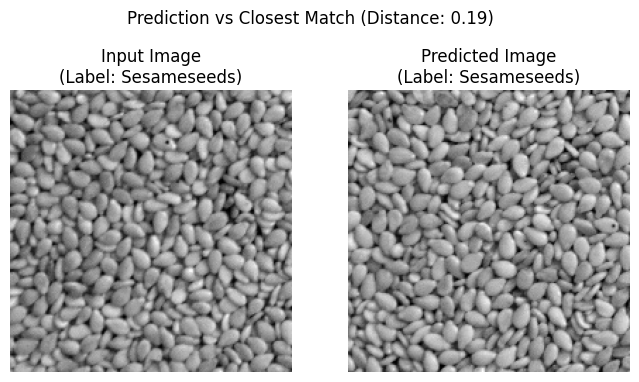

Predicción: Pearlsugar, Distancia: 0.40442507208055756


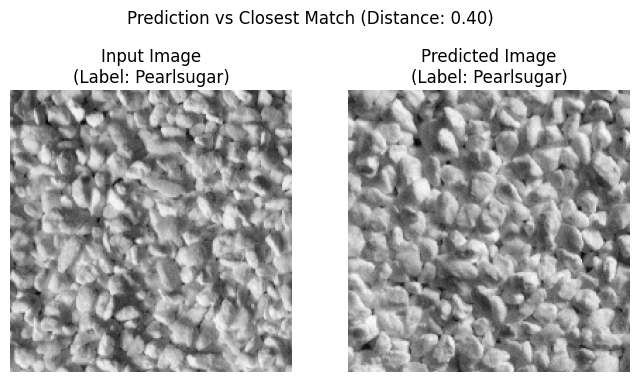

Predicción: Oatmeal, Distancia: 0.35138526531158143


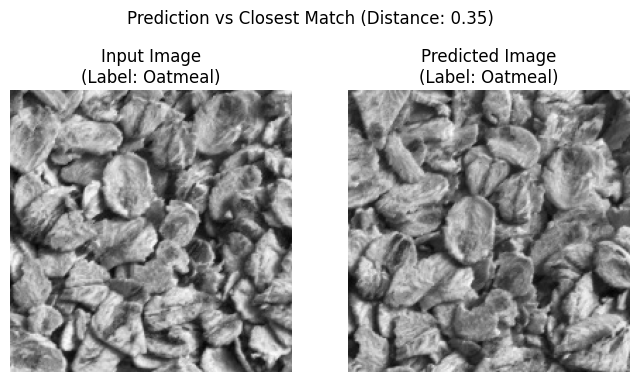

Predicción: Lentils, Distancia: 0.5853821419464056


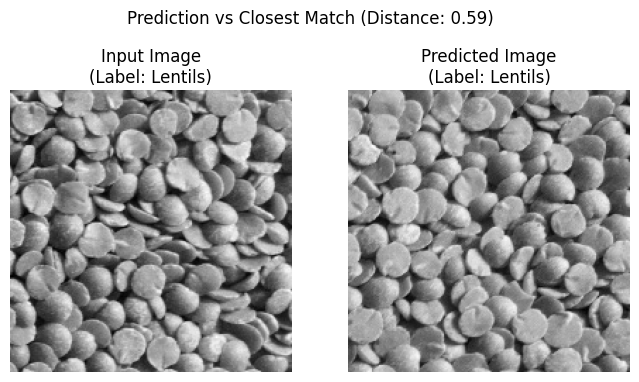

Predicción: Rice, Distancia: 0.5105344074818776


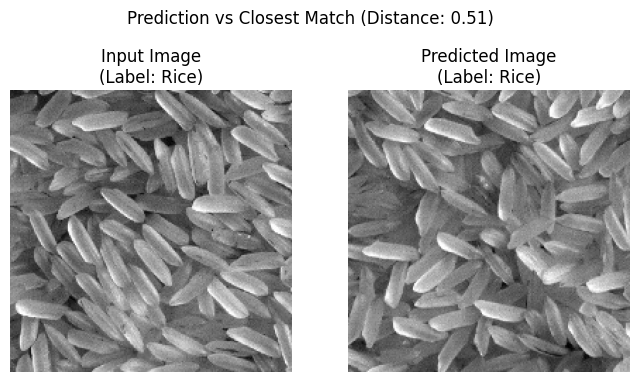

Predicción: Lentils, Distancia: 0.4518926686323159


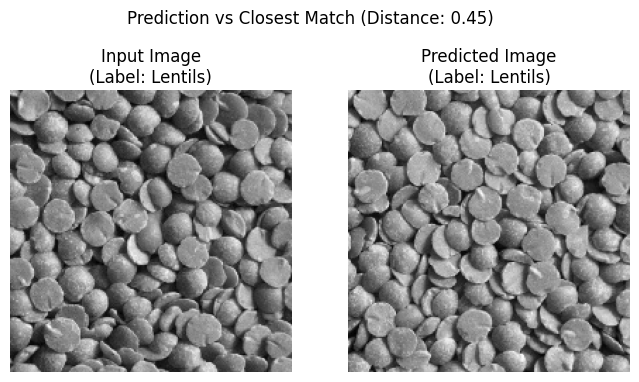

Predicción: Rice, Distancia: 0.4780543780110563


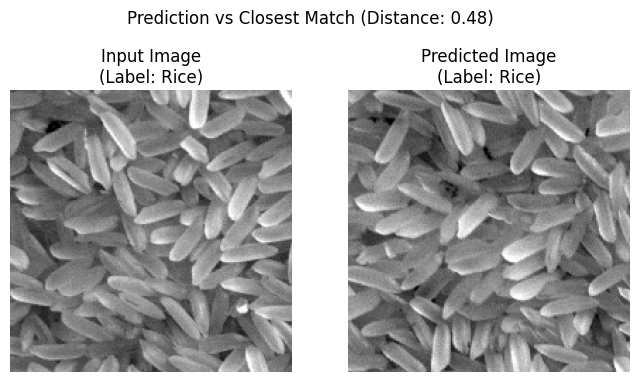

Predicción: Rice, Distancia: 0.3783981895584757


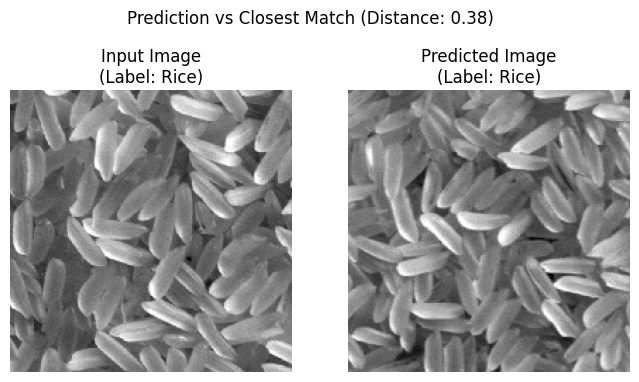

Predicción: Pearlsugar, Distancia: 0.5124266357695371


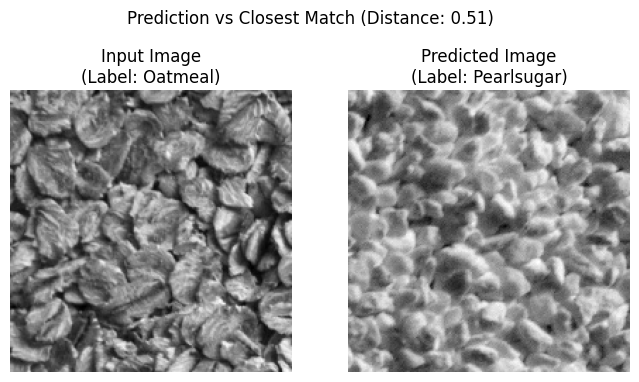

Predicción: Pearlsugar, Distancia: 0.4162174278207309


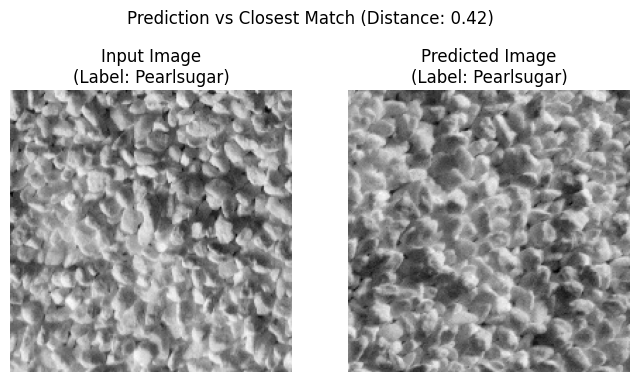

Predicción: Lentils, Distancia: 0.4116882249369739


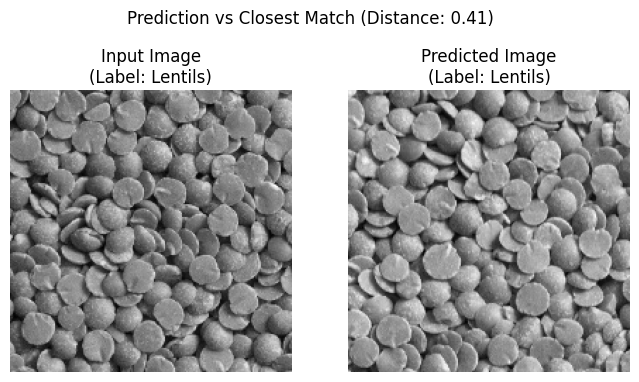

Predicción: Sesameseeds, Distancia: 0.2527390254089762


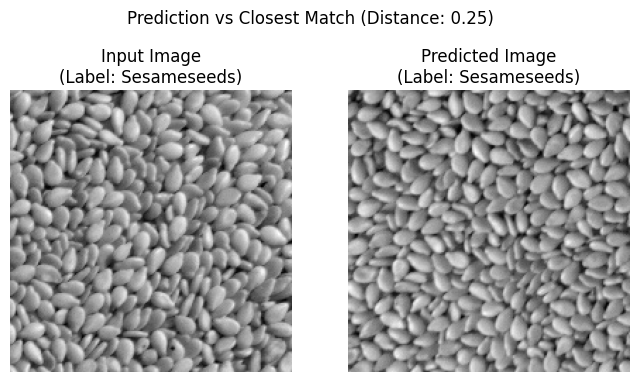

Predicción: Pearlsugar, Distancia: 0.35055356972673946


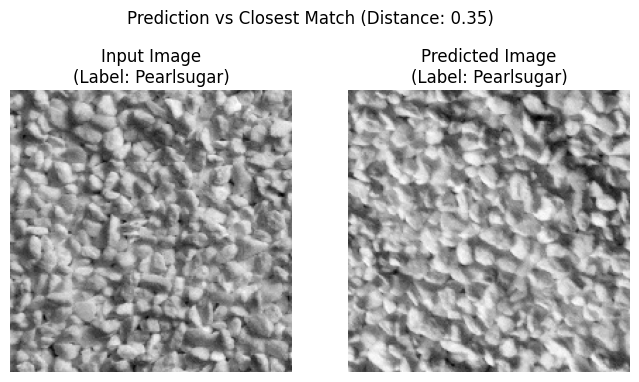

Predicción: Lentils, Distancia: 0.4142953939053915


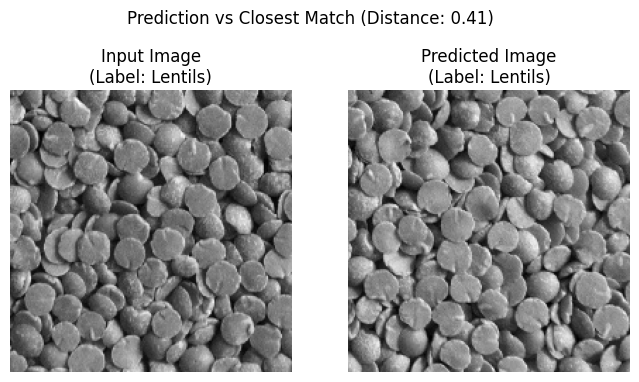

Predicción: Lentils, Distancia: 0.5203747232504159


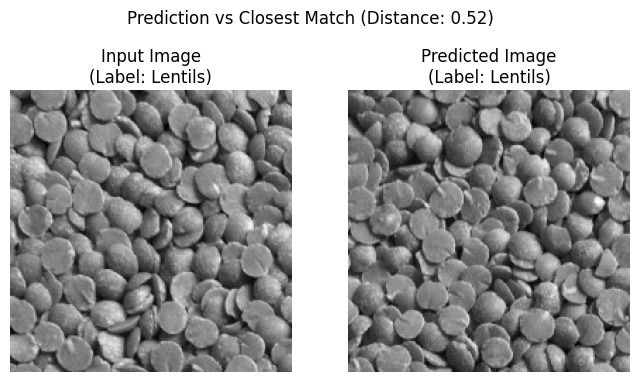

Predicción: Sesameseeds, Distancia: 0.14699782066045486


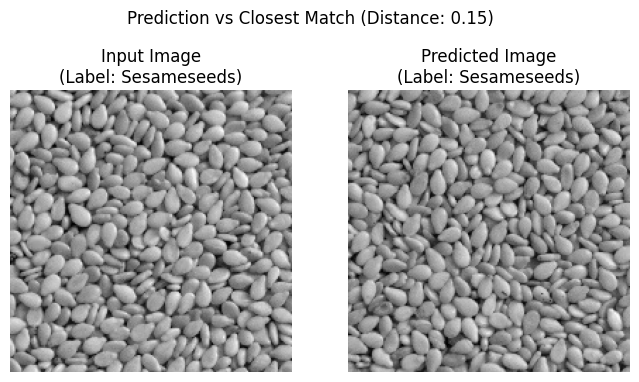

Predicción: Pearlsugar, Distancia: 0.30883109159275834


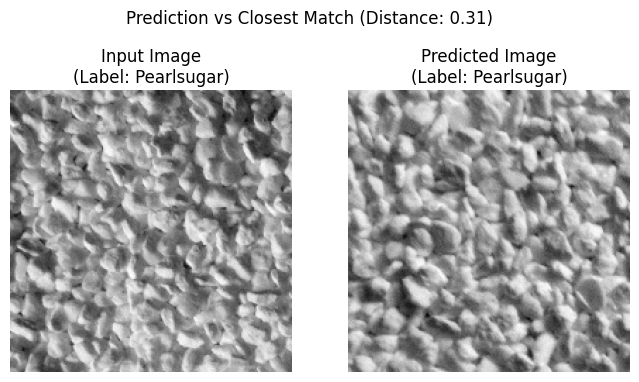

              precision    recall  f1-score   support

 Sesameseeds       1.00      1.00      1.00        16
     Oatmeal       1.00      0.62      0.77        16
        Rice       0.89      1.00      0.94        16
  Pearlsugar       0.75      0.94      0.83        16
     Lentils       1.00      1.00      1.00        16

    accuracy                           0.91        80
   macro avg       0.93      0.91      0.91        80
weighted avg       0.93      0.91      0.91        80



In [260]:
def predict_label(image_path, df_scattergram_means, true_label, scaler, kpca_best):
    """
    Predice la etiqueta de una nueva imagen comparándola con la base de datos mediante distancia coseno.
    También grafica la imagen de entrada junto a la imagen predicha.

    Parámetros:
    - image_path (str): Ruta de la nueva imagen.
    - df_scattergram_means (DataFrame): Base de datos de imágenes con sus características scattergram.
    - true_label (str): Etiqueta real de la imagen.

    Retorna:
    - label_predicho (str): Etiqueta de la imagen más cercana.
    - distancia_minima (float): Distancia mínima encontrada.
    - true_label (str): Etiqueta real de la imagen.
    """
    # Leer la imagen nueva y aplicar el mismo preprocesamiento
    img = read_images(image_path)
    if img is None:
        raise ValueError("No se pudo cargar la imagen. Verifica la ruta.")
    img = img.astype(np.float32) / 255.0

    # Calcular los coeficientes de Scattering2D
    Sx = compute_scattering2D(img=img, scattering=scattering_model).flatten()

    # Comparar con la base de datos usando distancia coseno
    min_distance = float("inf")
    best_match_label = None
    best_match_img_path = None

    for _, row in df_scattergram_means.iterrows():
        db_features = np.array(row.iloc[2:])  # Tomar desde la tercera columna en adelante
        new_image_features_scaled = kpca_best.transform(scaler.transform(Sx.reshape(1, -1))).flatten()
        distance = cosine(new_image_features_scaled, db_features)  # Distancia coseno
        # distance = euclidean(new_image_features_scaled, db_features)

        if distance < min_distance:
            min_distance = distance
            best_match_label = row["label"]
            best_match_img_path = row["image_path"]

    print(f"Predicción: {best_match_label}, Distancia: {min_distance}")

    # Leer la imagen de entrada y la imagen más cercana
    input_img = read_images(image_path)
    similar_img = read_images(best_match_img_path)

    # Graficar ambas imágenes una al lado de la otra
    fig, axes = plt.subplots(1, 2, figsize=(8, 4))

    axes[0].imshow(input_img, cmap="gray")
    axes[0].set_title(f"Input Image\n(Label: {true_label})")
    axes[0].axis("off")

    axes[1].imshow(similar_img, cmap="gray")
    axes[1].set_title(f"Predicted Image\n(Label: {best_match_label})")
    axes[1].axis("off")

    plt.suptitle(f"Prediction vs Closest Match (Distance: {min_distance:.2f})", y=1.05)
    plt.show()

    return best_match_label, min_distance, true_label

def evaluate_classification(df_test, df_scattergram_means, kpca_best):
    """
    Evalúa la precisión del modelo utilizando métricas de clasificación.

    Parámetros:
    - df_test (DataFrame): Base de datos de imágenes de prueba.
    - df_scattergram_means (DataFrame): Base de datos de imágenes con sus características scattergram.

    Retorna:
    - metrics (dict): Diccionario con las métricas de clasificación.
    """
    y_true = []
    y_pred = []

    for img_path, true_label in zip(df_test["image_path"].values, df_test["label"].values):
        pred_label, _, true_label = predict_label(img_path, df_scattergram_means, true_label, scaler, kpca_best)
        y_true.append(true_label)
        y_pred.append(pred_label)

    # Generar el classification report
    labels = df_test["label"].unique()
    report = classification_report(y_true, y_pred, target_names=labels)

    # # Calcular métricas de clasificación
    # accuracy = accuracy_score(y_true, y_pred)
    # precision = precision_score(y_true, y_pred, average="weighted", zero_division=0)
    # recall = recall_score(y_true, y_pred, average="weighted", zero_division=0)
    # f1 = f1_score(y_true, y_pred, average="weighted", zero_division=0)

    # metrics = {
    #     "Accuracy": accuracy,
    #     "Precision": precision,
    #     "Recall": recall,
    #     "F1 Score": f1
    # }

    # print("\n=== Classification Metrics ===")
    # for key, value in metrics.items():
    #     print(f"{key}: {value:.4f}")

    return report, y_true, y_pred, labels

# Filtrar el conjunto de prueba
df_test = df_images[df_images["set"] == "test"].sample(frac=1)  # Mezclar el conjunto de prueba

# Evaluar la clasificación
classification_metrics, y_true, y_pred, labels = evaluate_classification(df_test, df_wst_features, pca)
print(classification_metrics)

              precision    recall  f1-score   support

 Sesameseeds       1.00      1.00      1.00        16
     Oatmeal       1.00      0.62      0.77        16
        Rice       0.89      1.00      0.94        16
  Pearlsugar       0.75      0.94      0.83        16
     Lentils       1.00      1.00      1.00        16

    accuracy                           0.91        80
   macro avg       0.93      0.91      0.91        80
weighted avg       0.93      0.91      0.91        80



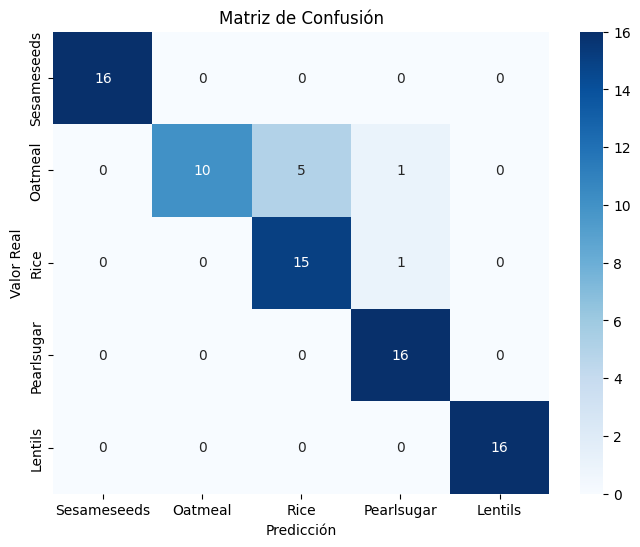

In [261]:
def plot_confusion_matrix(y_true, y_pred, labels, title='Matriz de Confusión'):
    """
    Genera y muestra una gráfica de la matriz de confusión usando seaborn.

    Parámetros:
        y_true (array-like): Valores reales.
        y_pred (array-like): Valores predichos.
        labels (list): Lista de etiquetas de las clases.
        title (str): Título de la gráfica.
    """
    # Calcular la matriz de confusión
    cm = confusion_matrix(y_true, y_pred, labels=labels)

    # Crear la figura
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicción')
    plt.ylabel('Valor Real')
    plt.title(title)
    plt.show()

# Ejemplo de uso:
# classification_metrics, y_true, y_pred, labels = evaluate_classification(df_test, df_wst_features, pca)
print(classification_metrics)
plot_confusion_matrix(y_true, y_pred, labels)

# FIN
---